In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import nibabel as nib
from matplotlib import pyplot as plt
import pydicom

device = torch.device('cuda:1' if torch.cuda.is_available() else 'cpu')
#device = 'cpu'

import os
import time
import glob
import numpy as np
from numpy import savez_compressed
from numpy import load
import torchvision.transforms as transforms

import gc
gc.collect()
torch.cuda.empty_cache()

### Preprocessing

In [2]:
transform = transforms.Compose([
                    transforms.ToTensor(),
                    transforms.Normalize([0.5],[0.5]),
                    transforms.Resize((256,256))
])

In [3]:
class DataLoader():
    def __init__(self, o_path, t_path):
        self.o_dataset = []
        self.t_dataset = []
        self.o_path = o_path
        self.t_path = t_path

    def preprocess(self):     
        org_patients = []
        
        # Reading and putting in Original Images
        for org_file in glob.glob(self.o_path):
            org_patient = []
            org_dcm = []
            
            org_name = org_file[31:]
            org_patients.append(org_name)
            
            for dcm_file in glob.glob(org_file + '/*'):
                dcm_base = os.path.basename(dcm_file)
                org_dcm.append(dcm_base)
            org_dcm.sort()
            
            
            for dcm_name in org_dcm:
                org_img = pydicom.dcmread(org_file + '/' + dcm_name)
                
                # convert dicom file to numpy array
                data1 = org_img.pixel_array
                data1 = data1.astype('float32')
                data1 = transform(data1)
                data1 = np.reshape(data1, (1,1,256,256))
                org_patient.append(data1)
            
            org_output = org_patient[0]

            count = 0
            for o_data in org_patient:
                if count == 0:
                    count += 1
                    continue
                org_output = torch.cat([org_output, o_data], 0)

            self.o_dataset.append(org_output)
            
        # TARGET
        
        for target_name in org_patients:
            tar_patient = []
            tar_dcm = []
            
            for dcm_file in glob.glob(self.t_path + target_name + '/*'):
                dcm_base = os.path.basename(dcm_file)
                tar_dcm.append(dcm_base)
            tar_dcm.sort()
            
            for dcm_name in tar_dcm:
                tar_img = pydicom.dcmread(self.t_path + target_name + '/' + dcm_name)
                
                # convert dicom file to numpy array
                data2 = tar_img.pixel_array
                data2 = data2.astype('float32')
                data2 = transform(data2)
                data2 = np.reshape(data2, (1,1,256,256))
                tar_patient.append(data2)
            
            tar_output = tar_patient[0]
            
            count = 0
            for t_data in tar_patient:
                if count == 0:
                    count += 1
                    continue
                tar_output = torch.cat([tar_output, t_data], 0)
            
            self.t_dataset.append(tar_output)
            
        return self.o_dataset, self.t_dataset

In [4]:
data = DataLoader('/home/mri-any/GAN_Data/orignal/*', '/home/mri-any/GAN_Data/target/')

orig, target = data.preprocess()

### Generator Model ###

In [5]:
# UNet
class UNetDown(nn.Module):
    def __init__(self, in_channels, out_channels, normalize=True, dropout=0.0):
        super().__init__()

        layers = [nn.Conv2d(in_channels, out_channels, 4, stride=2, padding=1, bias=False)]

        if normalize:
            layers.append(nn.InstanceNorm2d(out_channels)),

        layers.append(nn.LeakyReLU(0.2))

        if dropout:
            layers.append(nn.Dropout(dropout))

        self.down = nn.Sequential(*layers)

    def forward(self, x):
        x = self.down(x)
        return x

In [6]:
class UNetUp(nn.Module):
    def __init__(self, in_channels, out_channels, dropout=0.0):
        super().__init__()

        layers = [
            nn.ConvTranspose2d(in_channels, out_channels,4,2,1,bias=False),
            nn.InstanceNorm2d(out_channels),
            nn.LeakyReLU()
        ]

        if dropout:
            layers.append(nn.Dropout(dropout))

        self.up = nn.Sequential(*layers)

    def forward(self,x,skip):
        x = self.up(x)
        x = torch.cat((x,skip),1)
        return x

In [7]:
# generator: 가짜 이미지를 생성합니다.
class GeneratorUNet(nn.Module):
    def __init__(self, in_channels=1, out_channels=1):
        super().__init__()

        self.down1 = UNetDown(in_channels, 64, normalize=False)
        self.down2 = UNetDown(64,128)                 
        self.down3 = UNetDown(128,256)               
        self.down4 = UNetDown(256,512,dropout=0.5) 
        self.down5 = UNetDown(512,512,dropout=0.5)      
        self.down6 = UNetDown(512,512,dropout=0.5)             
        self.down7 = UNetDown(512,512,dropout=0.5)              
        self.down8 = UNetDown(512,512,normalize=False,dropout=0.5)

        self.up1 = UNetUp(512,512,dropout=0.5)
        self.up2 = UNetUp(1024,512,dropout=0.5)
        self.up3 = UNetUp(1024,512,dropout=0.5)
        self.up4 = UNetUp(1024,512,dropout=0.5)
        self.up5 = UNetUp(1024,256)
        self.up6 = UNetUp(512,128)
        self.up7 = UNetUp(256,64)
        self.up8 = nn.Sequential(
            nn.ConvTranspose2d(128,1,4,stride=2,padding=1),
            nn.Tanh()
        )

    def forward(self, x):
        d1 = self.down1(x)
        d2 = self.down2(d1)
        d3 = self.down3(d2)
        d4 = self.down4(d3)
        d5 = self.down5(d4)
        d6 = self.down6(d5)
        d7 = self.down7(d6)
        d8 = self.down8(d7)

        u1 = self.up1(d8,d7)
        u2 = self.up2(u1,d6)
        u3 = self.up3(u2,d5)
        u4 = self.up4(u3,d4)
        u5 = self.up5(u4,d3)
        u6 = self.up6(u5,d2)
        u7 = self.up7(u6,d1)
        u8 = self.up8(u7)

        return u8

### Discriminator Model

In [8]:
class Dis_block(nn.Module):
    def __init__(self, in_channels, out_channels, normalize=True):
        super().__init__()

        layers = [nn.Conv2d(in_channels, out_channels, 3, stride=2, padding=1)]
        if normalize:
            layers.append(nn.InstanceNorm2d(out_channels))
        layers.append(nn.LeakyReLU(0.2))
    
        self.block = nn.Sequential(*layers)

    def forward(self, x):
        x = self.block(x)
        return x

In [9]:
class Discriminator(nn.Module):
    def __init__(self, in_channels=1):
        super().__init__()
        self.stage_1 = Dis_block(in_channels*2,16,normalize=False)
        self.stage_2 = Dis_block(16,32)
        self.stage_3 = Dis_block(32,64)
        self.stage_4 = Dis_block(64,128)
        self.fc1 = torch.nn.Linear(2621440, 2)

    def forward(self,a,b):
        x = torch.cat((a,b),1)
        x = self.stage_1(x)
        x = self.stage_2(x)
        x = self.stage_3(x)
        x = self.stage_4(x)

        x = torch.flatten(x)
        x = self.fc1(x)
        
        return x

### Training

In [10]:
model_gen = GeneratorUNet().to(device)
model_dis = Discriminator().to(device)

In [11]:
# 가중치 초기화
def initialize_weights(model):
    class_name = model.__class__.__name__
    if class_name.find('Conv') != -1:
        nn.init.normal_(model.weight.data, 0.0, 0.02)


# 가중치 초기화 적용
model_gen.apply(initialize_weights);
model_dis.apply(initialize_weights);

In [12]:
def gradient_loss(gen_frames, gt_frames, alpha=1):

    def gradient(x):
        # idea from tf.image.image_gradients(image)
        # https://github.com/tensorflow/tensorflow/blob/r2.1/tensorflow/python/ops/image_ops_impl.py#L3441-L3512
        # x: (b,c,h,w), float32 or float64
        # dx, dy: (b,c,h,w)

        h_x = x.size()[-2]
        w_x = x.size()[-1]
        # gradient step=1
        left = x
        right = F.pad(x, [0, 1, 0, 0])[:, :, :, 1:]
        top = x
        bottom = F.pad(x, [0, 0, 0, 1])[:, :, 1:, :]

        # dx, dy = torch.abs(right - left), torch.abs(bottom - top)
        dx, dy = right - left, bottom - top 
        # dx will always have zeros in the last column, right-left
        # dy will always have zeros in the last row,    bottom-top
        dx[:, :, :, -1] = 0
        dy[:, :, -1, :] = 0

        return dx, dy

    # gradient
    gen_dx, gen_dy = gradient(gen_frames)
    gt_dx, gt_dy = gradient(gt_frames)
    #
    grad_diff_x = torch.abs(gt_dx - gen_dx)
    grad_diff_y = torch.abs(gt_dy - gen_dy)

    # condense into one tensor and avg
    return torch.mean(grad_diff_x ** alpha + grad_diff_y ** alpha)

In [13]:
# 손실함수
loss_func_gan = nn.BCEWithLogitsLoss()
loss_func_pix = nn.L1Loss()

# loss_func_pix 가중치
lambda_pixel = 100
lambda_gradient = 500
lambda_gen = 1

# 최적화 파라미터
from torch import optim
g_lr = 1e-4
d_lr = 1e-8
beta1 = 0.5
beta2 = 0.999

opt_dis = optim.Adam(model_dis.parameters(),lr=d_lr,betas=(beta1,beta2))
opt_gen = optim.Adam(model_gen.parameters(),lr=g_lr,betas=(beta1,beta2))

Epoch: 0, G_Loss: 2513601.250000, D_Loss: 0.587438, time: 0.01 min


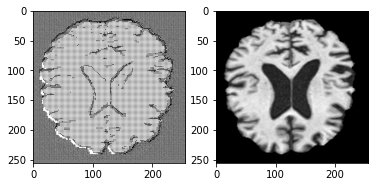

Epoch: 0, G_Loss: 2523202.000000, D_Loss: 0.648515, time: 0.02 min


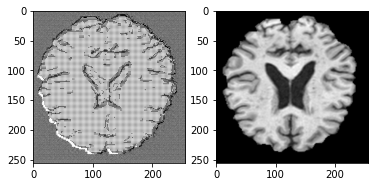

Epoch: 0, G_Loss: 2884248.500000, D_Loss: 0.644441, time: 0.04 min


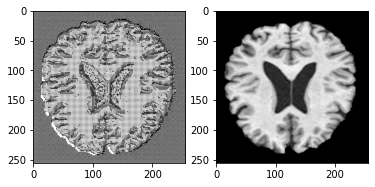

Epoch: 1, G_Loss: 2513546.000000, D_Loss: 0.581535, time: 0.05 min


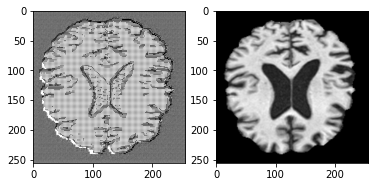

Epoch: 1, G_Loss: 2523172.500000, D_Loss: 0.642626, time: 0.06 min


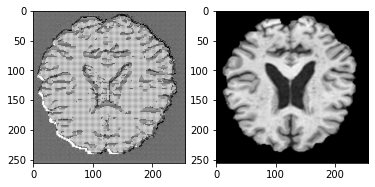

Epoch: 1, G_Loss: 2884226.750000, D_Loss: 0.639256, time: 0.08 min


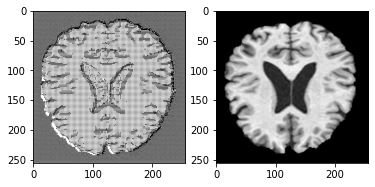

Epoch: 2, G_Loss: 2513530.500000, D_Loss: 0.576265, time: 0.09 min


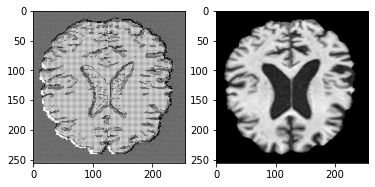

Epoch: 2, G_Loss: 2523160.250000, D_Loss: 0.636923, time: 0.10 min


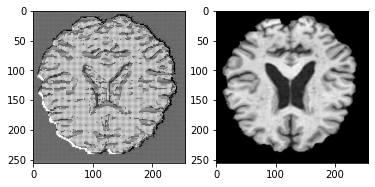

Epoch: 2, G_Loss: 2884217.000000, D_Loss: 0.634118, time: 0.12 min


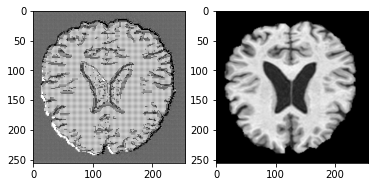

Epoch: 3, G_Loss: 2513521.500000, D_Loss: 0.571040, time: 0.13 min


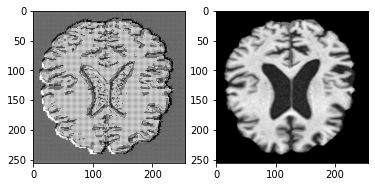

Epoch: 3, G_Loss: 2523144.750000, D_Loss: 0.631262, time: 0.14 min


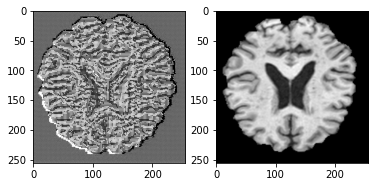

Epoch: 3, G_Loss: 2884213.750000, D_Loss: 0.629035, time: 0.16 min


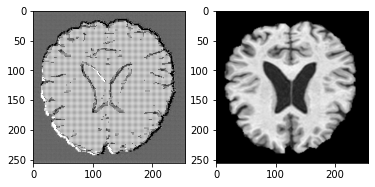

Epoch: 4, G_Loss: 2513520.000000, D_Loss: 0.565845, time: 0.17 min


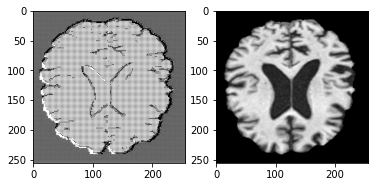

Epoch: 4, G_Loss: 2523149.000000, D_Loss: 0.625671, time: 0.18 min


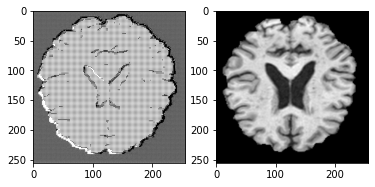

Epoch: 4, G_Loss: 2884205.000000, D_Loss: 0.624012, time: 0.20 min


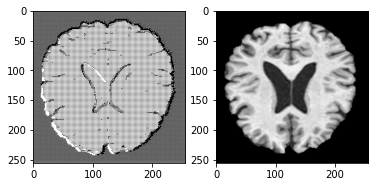

Epoch: 5, G_Loss: 2513515.250000, D_Loss: 0.560691, time: 0.21 min


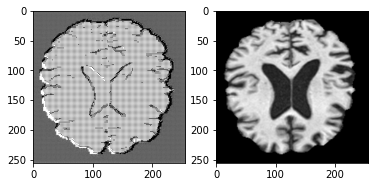

Epoch: 5, G_Loss: 2523145.250000, D_Loss: 0.620121, time: 0.22 min


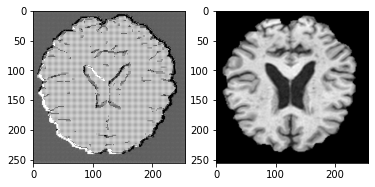

Epoch: 5, G_Loss: 2884198.750000, D_Loss: 0.619035, time: 0.24 min


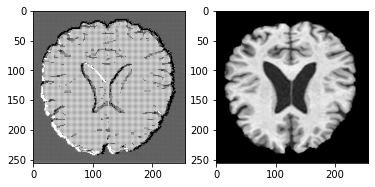

Epoch: 6, G_Loss: 2513508.000000, D_Loss: 0.555572, time: 0.25 min


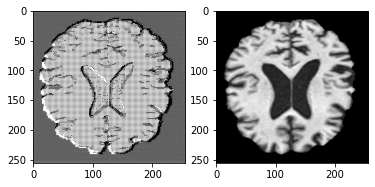

Epoch: 6, G_Loss: 2523135.000000, D_Loss: 0.614621, time: 0.26 min


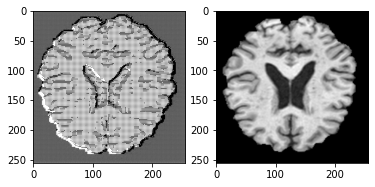

Epoch: 6, G_Loss: 2884191.000000, D_Loss: 0.614102, time: 0.28 min


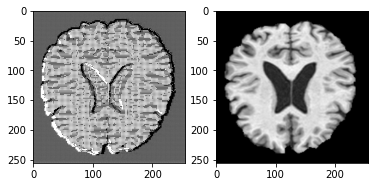

Epoch: 7, G_Loss: 2513504.000000, D_Loss: 0.550489, time: 0.29 min


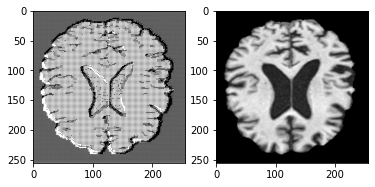

Epoch: 7, G_Loss: 2523133.000000, D_Loss: 0.609180, time: 0.30 min


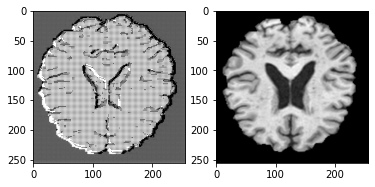

Epoch: 7, G_Loss: 2884190.000000, D_Loss: 0.609220, time: 0.32 min


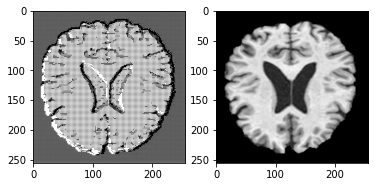

Epoch: 8, G_Loss: 2513499.750000, D_Loss: 0.545475, time: 0.33 min


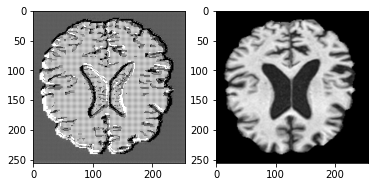

Epoch: 8, G_Loss: 2523123.500000, D_Loss: 0.603779, time: 0.34 min


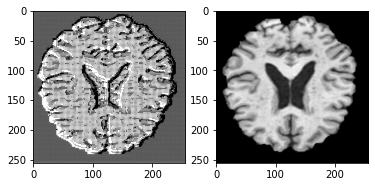

Epoch: 8, G_Loss: 2884178.500000, D_Loss: 0.604378, time: 0.36 min


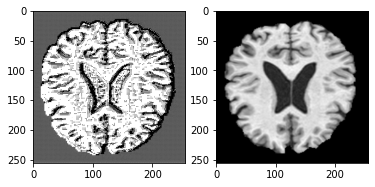

Epoch: 9, G_Loss: 2513468.750000, D_Loss: 0.540501, time: 0.37 min


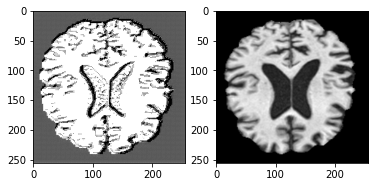

Epoch: 9, G_Loss: 2523087.250000, D_Loss: 0.598449, time: 0.38 min


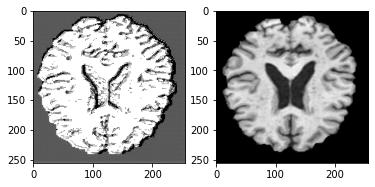

Epoch: 9, G_Loss: 2884149.500000, D_Loss: 0.599601, time: 0.40 min


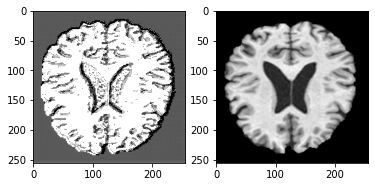

Epoch: 10, G_Loss: 2513463.250000, D_Loss: 0.535583, time: 0.41 min


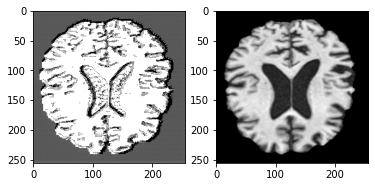

Epoch: 10, G_Loss: 2523085.000000, D_Loss: 0.593166, time: 0.42 min


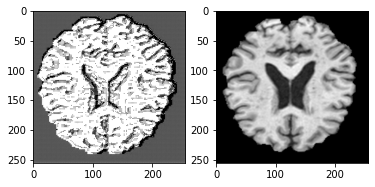

Epoch: 10, G_Loss: 2884147.000000, D_Loss: 0.594855, time: 0.44 min


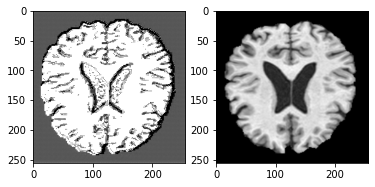

Epoch: 11, G_Loss: 2513461.500000, D_Loss: 0.530708, time: 0.45 min


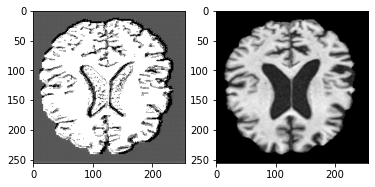

Epoch: 11, G_Loss: 2523083.500000, D_Loss: 0.587936, time: 0.47 min


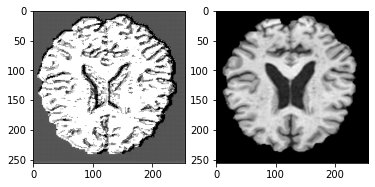

Epoch: 11, G_Loss: 2884141.750000, D_Loss: 0.590154, time: 0.48 min


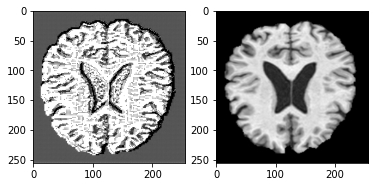

Epoch: 12, G_Loss: 2513458.750000, D_Loss: 0.525882, time: 0.49 min


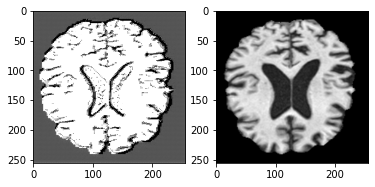

Epoch: 12, G_Loss: 2523083.000000, D_Loss: 0.582752, time: 0.51 min


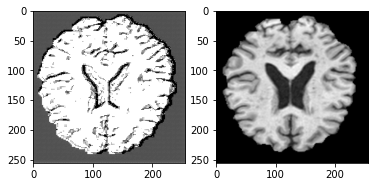

Epoch: 12, G_Loss: 2884144.000000, D_Loss: 0.585495, time: 0.52 min


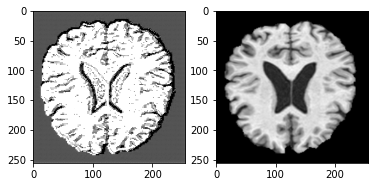

Epoch: 13, G_Loss: 2513457.000000, D_Loss: 0.521106, time: 0.53 min


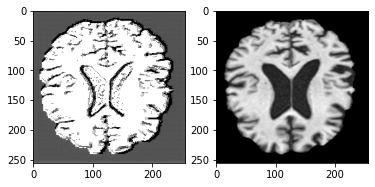

Epoch: 13, G_Loss: 2523079.000000, D_Loss: 0.577628, time: 0.55 min


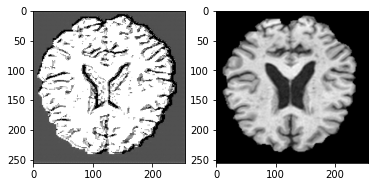

Epoch: 13, G_Loss: 2884138.500000, D_Loss: 0.580877, time: 0.56 min


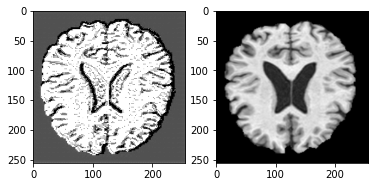

Epoch: 14, G_Loss: 2513452.250000, D_Loss: 0.516377, time: 0.57 min


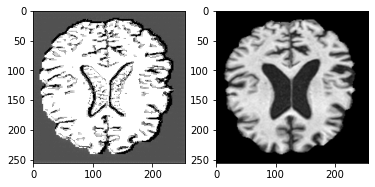

Epoch: 14, G_Loss: 2523075.000000, D_Loss: 0.572554, time: 0.58 min


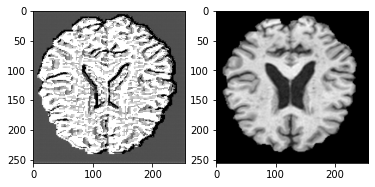

Epoch: 14, G_Loss: 2884139.000000, D_Loss: 0.576293, time: 0.60 min


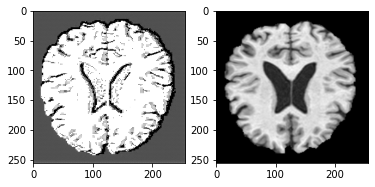

Epoch: 15, G_Loss: 2513455.250000, D_Loss: 0.511690, time: 0.61 min


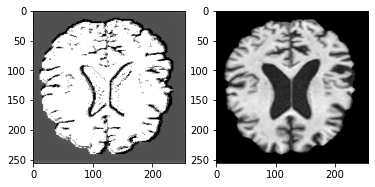

Epoch: 15, G_Loss: 2523080.000000, D_Loss: 0.567528, time: 0.63 min


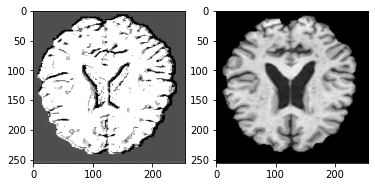

Epoch: 15, G_Loss: 2884139.000000, D_Loss: 0.571766, time: 0.64 min


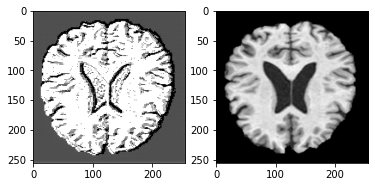

Epoch: 16, G_Loss: 2513452.000000, D_Loss: 0.507067, time: 0.65 min


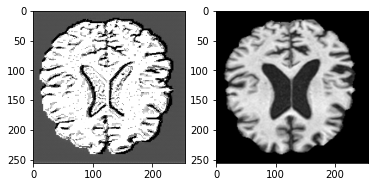

Epoch: 16, G_Loss: 2523072.250000, D_Loss: 0.562557, time: 0.67 min


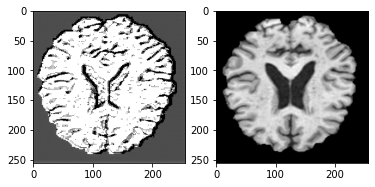

Epoch: 16, G_Loss: 2884132.250000, D_Loss: 0.567278, time: 0.68 min


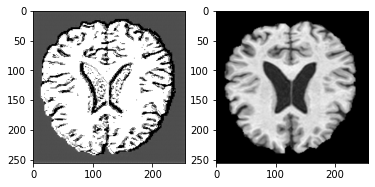

Epoch: 17, G_Loss: 2513447.750000, D_Loss: 0.502493, time: 0.69 min


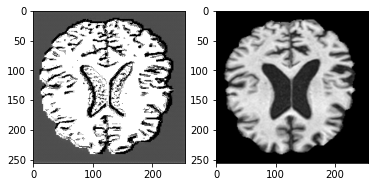

Epoch: 17, G_Loss: 2523065.750000, D_Loss: 0.557639, time: 0.71 min


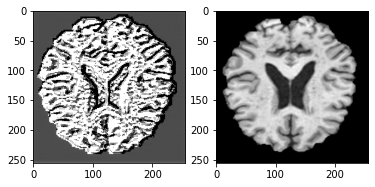

Epoch: 17, G_Loss: 2884131.000000, D_Loss: 0.562820, time: 0.72 min


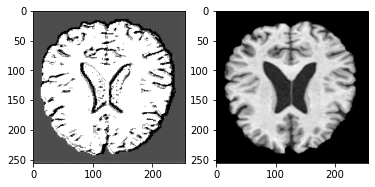

Epoch: 18, G_Loss: 2513448.500000, D_Loss: 0.497951, time: 0.73 min


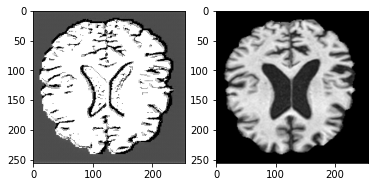

Epoch: 18, G_Loss: 2523073.250000, D_Loss: 0.552764, time: 0.75 min


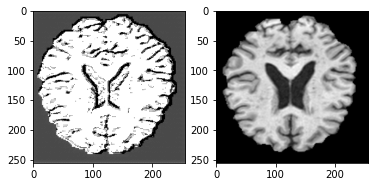

Epoch: 18, G_Loss: 2884132.500000, D_Loss: 0.558408, time: 0.76 min


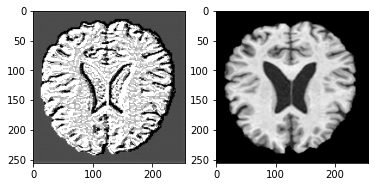

Epoch: 19, G_Loss: 2513450.500000, D_Loss: 0.493473, time: 0.77 min


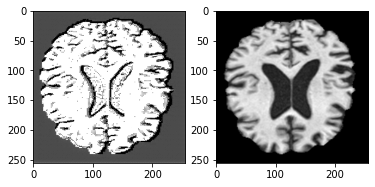

Epoch: 19, G_Loss: 2523071.750000, D_Loss: 0.547941, time: 0.79 min


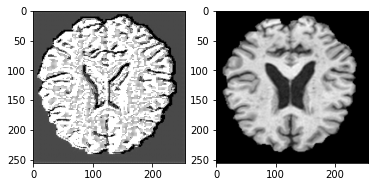

Epoch: 19, G_Loss: 2884137.750000, D_Loss: 0.554039, time: 0.80 min


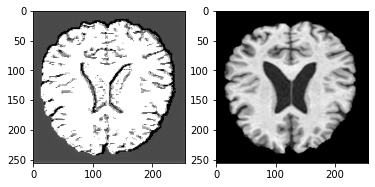

Epoch: 20, G_Loss: 2513451.750000, D_Loss: 0.489031, time: 0.81 min


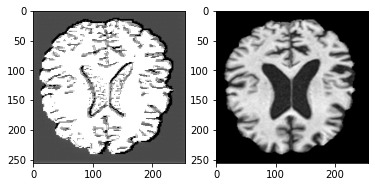

Epoch: 20, G_Loss: 2523075.750000, D_Loss: 0.543174, time: 0.83 min


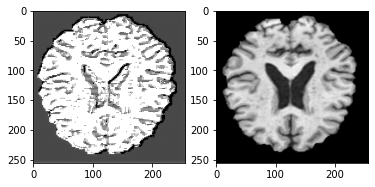

Epoch: 20, G_Loss: 2884137.750000, D_Loss: 0.549705, time: 0.84 min


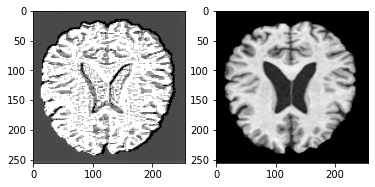

Epoch: 21, G_Loss: 2513454.500000, D_Loss: 0.484633, time: 0.85 min


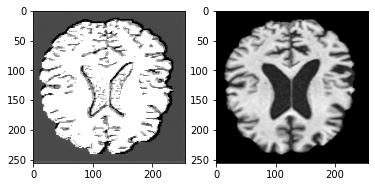

Epoch: 21, G_Loss: 2523076.000000, D_Loss: 0.538445, time: 0.87 min


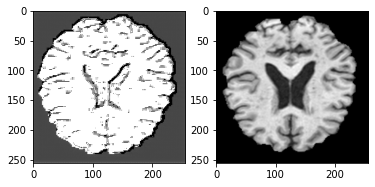

Epoch: 21, G_Loss: 2884137.500000, D_Loss: 0.545417, time: 0.88 min


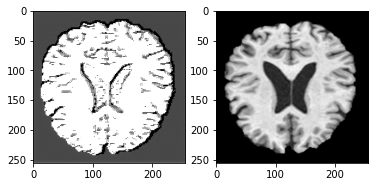

Epoch: 22, G_Loss: 2513451.000000, D_Loss: 0.480286, time: 0.90 min


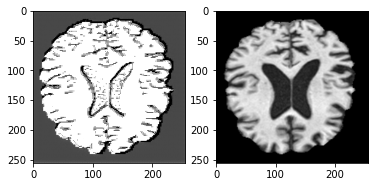

Epoch: 22, G_Loss: 2523074.000000, D_Loss: 0.533771, time: 0.91 min


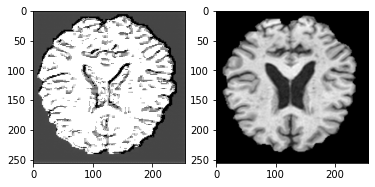

Epoch: 22, G_Loss: 2884134.000000, D_Loss: 0.541158, time: 0.92 min


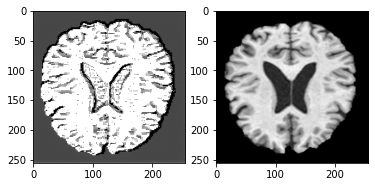

Epoch: 23, G_Loss: 2513447.500000, D_Loss: 0.475979, time: 0.94 min


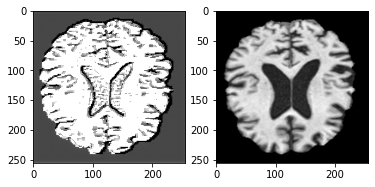

Epoch: 23, G_Loss: 2523068.250000, D_Loss: 0.529138, time: 0.95 min


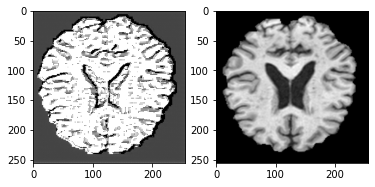

Epoch: 23, G_Loss: 2884129.500000, D_Loss: 0.536938, time: 0.96 min


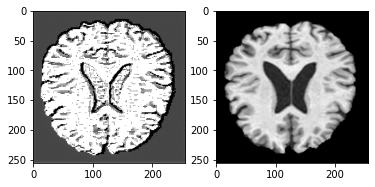

Epoch: 24, G_Loss: 2513443.750000, D_Loss: 0.471718, time: 0.98 min


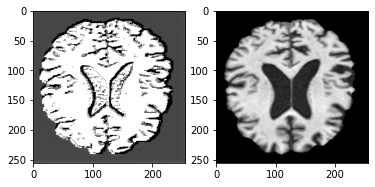

Epoch: 24, G_Loss: 2523063.750000, D_Loss: 0.524554, time: 0.99 min


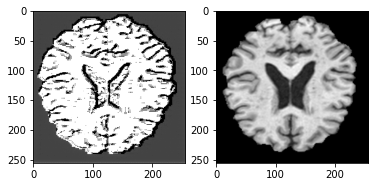

Epoch: 24, G_Loss: 2884123.750000, D_Loss: 0.532762, time: 1.00 min


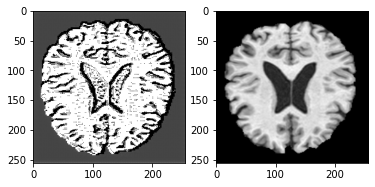

Epoch: 25, G_Loss: 2513436.750000, D_Loss: 0.467522, time: 1.02 min


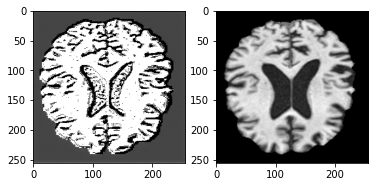

Epoch: 25, G_Loss: 2523053.750000, D_Loss: 0.520012, time: 1.03 min


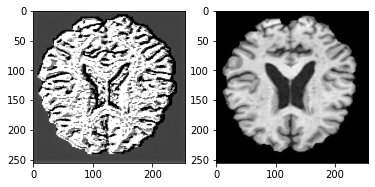

Epoch: 25, G_Loss: 2884120.250000, D_Loss: 0.528629, time: 1.04 min


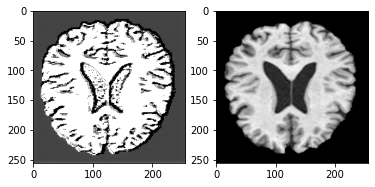

Epoch: 26, G_Loss: 2513437.500000, D_Loss: 0.463354, time: 1.06 min


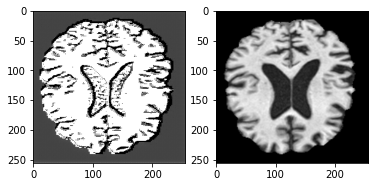

Epoch: 26, G_Loss: 2523058.750000, D_Loss: 0.515529, time: 1.07 min


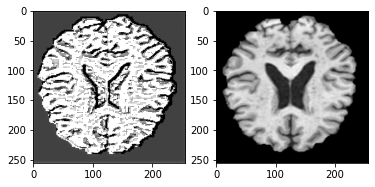

Epoch: 26, G_Loss: 2884122.500000, D_Loss: 0.524518, time: 1.08 min


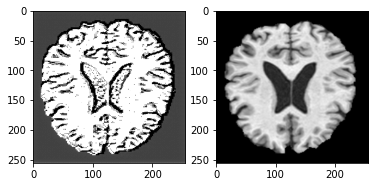

Epoch: 27, G_Loss: 2513436.250000, D_Loss: 0.459244, time: 1.10 min


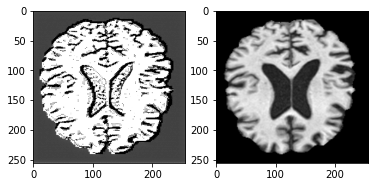

Epoch: 27, G_Loss: 2523054.000000, D_Loss: 0.511075, time: 1.11 min


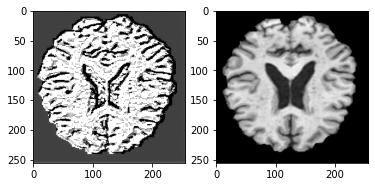

Epoch: 27, G_Loss: 2884118.000000, D_Loss: 0.520465, time: 1.12 min


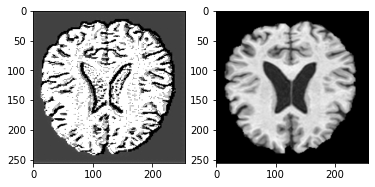

Epoch: 28, G_Loss: 2513436.750000, D_Loss: 0.455154, time: 1.14 min


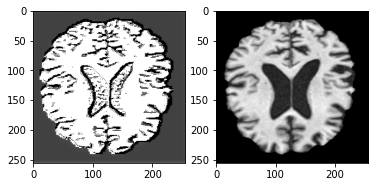

Epoch: 28, G_Loss: 2523056.500000, D_Loss: 0.506681, time: 1.15 min


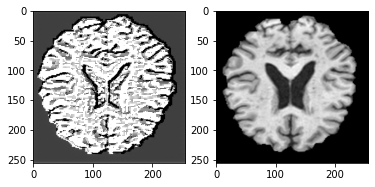

Epoch: 28, G_Loss: 2884121.500000, D_Loss: 0.516429, time: 1.16 min


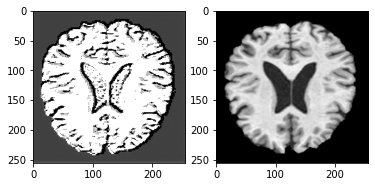

Epoch: 29, G_Loss: 2513438.000000, D_Loss: 0.451118, time: 1.18 min


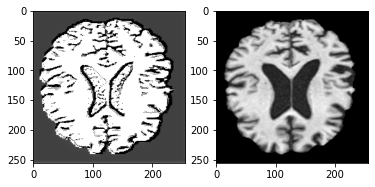

Epoch: 29, G_Loss: 2523056.750000, D_Loss: 0.502323, time: 1.19 min


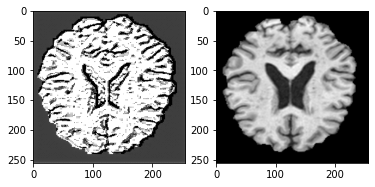

Epoch: 29, G_Loss: 2884117.250000, D_Loss: 0.512447, time: 1.20 min


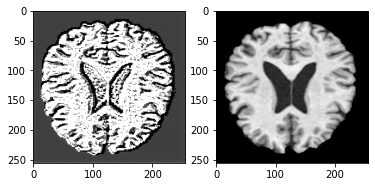

Epoch: 30, G_Loss: 2513434.000000, D_Loss: 0.447131, time: 1.22 min


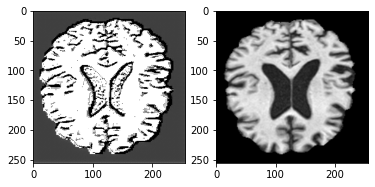

Epoch: 30, G_Loss: 2523054.000000, D_Loss: 0.498015, time: 1.23 min


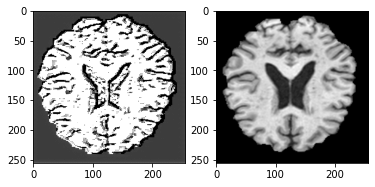

Epoch: 30, G_Loss: 2884115.500000, D_Loss: 0.508483, time: 1.24 min


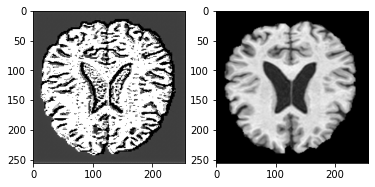

Epoch: 31, G_Loss: 2513431.750000, D_Loss: 0.443172, time: 1.26 min


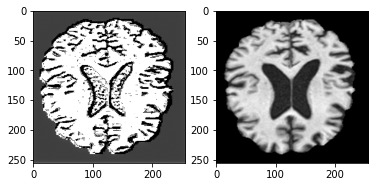

Epoch: 31, G_Loss: 2523047.000000, D_Loss: 0.493753, time: 1.27 min


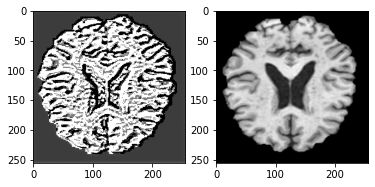

Epoch: 31, G_Loss: 2884113.000000, D_Loss: 0.504568, time: 1.28 min


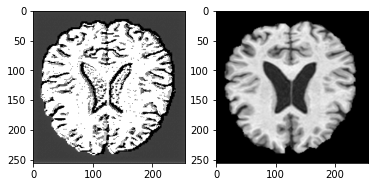

Epoch: 32, G_Loss: 2513432.500000, D_Loss: 0.439264, time: 1.30 min


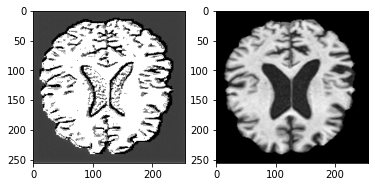

Epoch: 32, G_Loss: 2523054.500000, D_Loss: 0.489532, time: 1.31 min


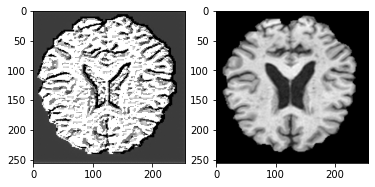

Epoch: 32, G_Loss: 2884118.000000, D_Loss: 0.500679, time: 1.33 min


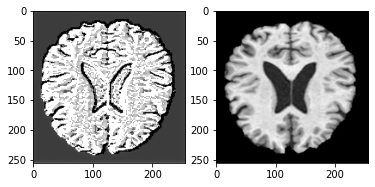

Epoch: 33, G_Loss: 2513439.500000, D_Loss: 0.435395, time: 1.34 min


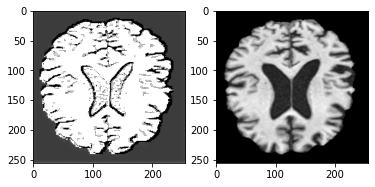

Epoch: 33, G_Loss: 2523061.000000, D_Loss: 0.485358, time: 1.35 min


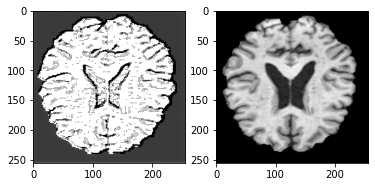

Epoch: 33, G_Loss: 2884123.250000, D_Loss: 0.496833, time: 1.37 min


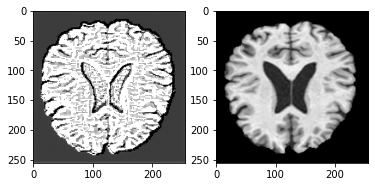

Epoch: 34, G_Loss: 2513440.250000, D_Loss: 0.431573, time: 1.38 min


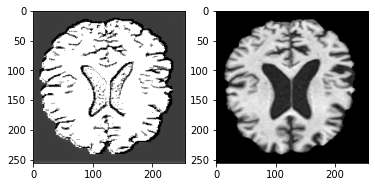

Epoch: 34, G_Loss: 2523060.000000, D_Loss: 0.481214, time: 1.39 min


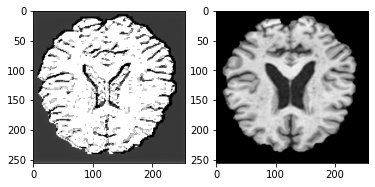

Epoch: 34, G_Loss: 2884119.500000, D_Loss: 0.493022, time: 1.41 min


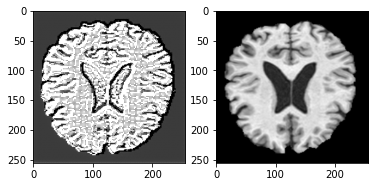

Epoch: 35, G_Loss: 2513439.500000, D_Loss: 0.427795, time: 1.42 min


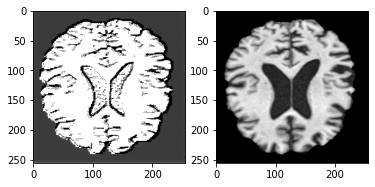

Epoch: 35, G_Loss: 2523059.500000, D_Loss: 0.477124, time: 1.43 min


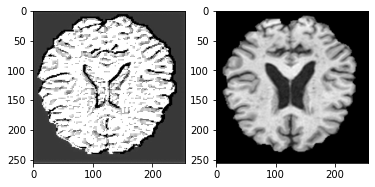

Epoch: 35, G_Loss: 2884120.750000, D_Loss: 0.489242, time: 1.45 min


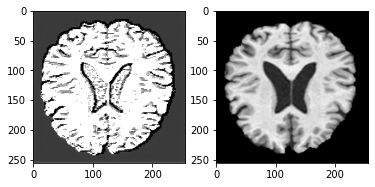

Epoch: 36, G_Loss: 2513435.750000, D_Loss: 0.424041, time: 1.46 min


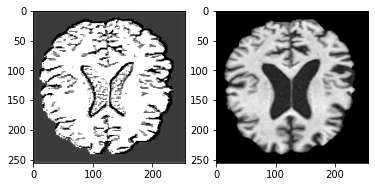

Epoch: 36, G_Loss: 2523054.750000, D_Loss: 0.473072, time: 1.47 min


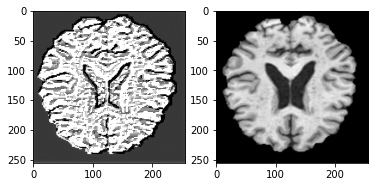

Epoch: 36, G_Loss: 2884117.500000, D_Loss: 0.485494, time: 1.49 min


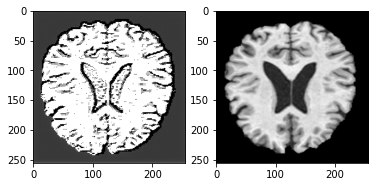

Epoch: 37, G_Loss: 2513432.500000, D_Loss: 0.420335, time: 1.50 min


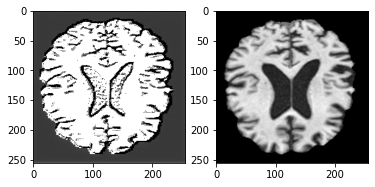

Epoch: 37, G_Loss: 2523053.000000, D_Loss: 0.469058, time: 1.52 min


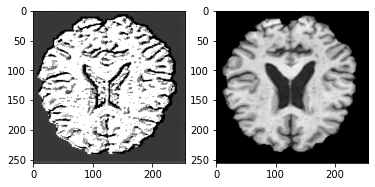

Epoch: 37, G_Loss: 2884112.500000, D_Loss: 0.481789, time: 1.53 min


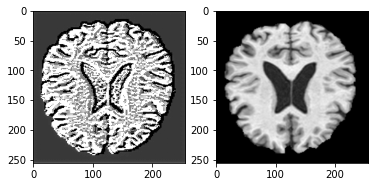

Epoch: 38, G_Loss: 2513435.750000, D_Loss: 0.416672, time: 1.54 min


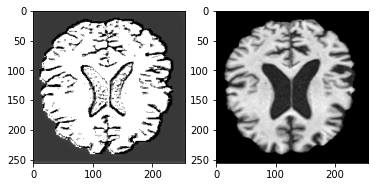

Epoch: 38, G_Loss: 2523052.750000, D_Loss: 0.465083, time: 1.56 min


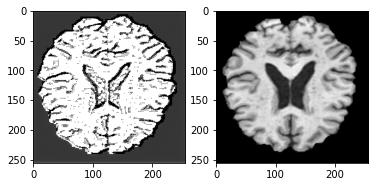

Epoch: 38, G_Loss: 2884114.000000, D_Loss: 0.478115, time: 1.57 min


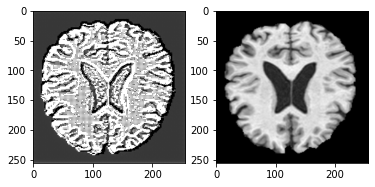

Epoch: 39, G_Loss: 2513438.750000, D_Loss: 0.413045, time: 1.58 min


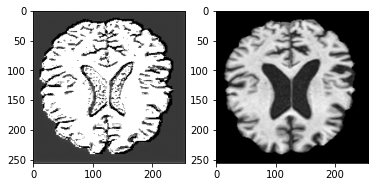

Epoch: 39, G_Loss: 2523052.250000, D_Loss: 0.461155, time: 1.60 min


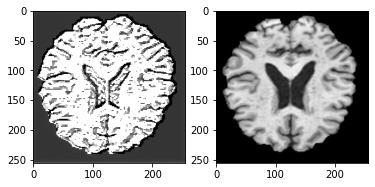

Epoch: 39, G_Loss: 2884114.500000, D_Loss: 0.474474, time: 1.61 min


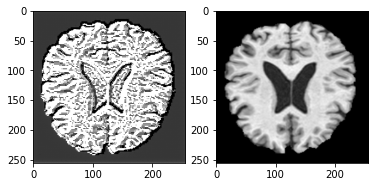

Epoch: 40, G_Loss: 2513436.500000, D_Loss: 0.409461, time: 1.62 min


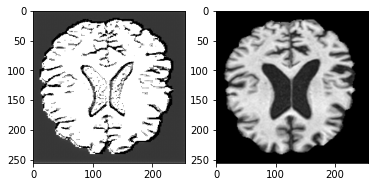

Epoch: 40, G_Loss: 2523057.250000, D_Loss: 0.457265, time: 1.64 min


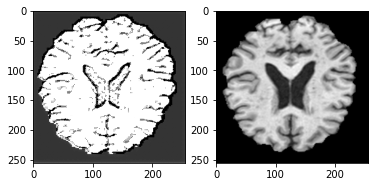

Epoch: 40, G_Loss: 2884118.750000, D_Loss: 0.470862, time: 1.65 min


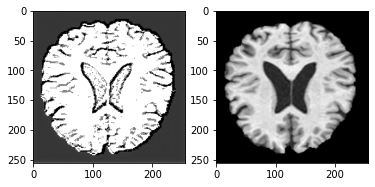

Epoch: 41, G_Loss: 2513433.500000, D_Loss: 0.405908, time: 1.66 min


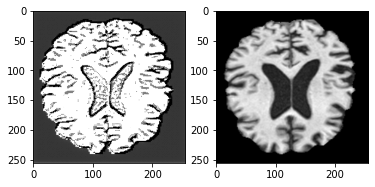

Epoch: 41, G_Loss: 2523052.000000, D_Loss: 0.453419, time: 1.68 min


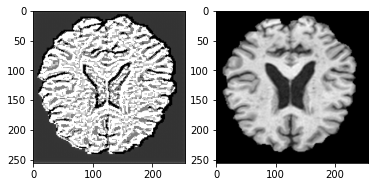

Epoch: 41, G_Loss: 2884114.750000, D_Loss: 0.467283, time: 1.69 min


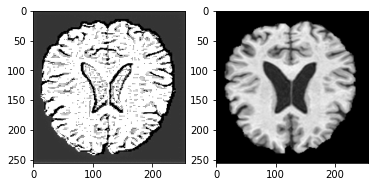

Epoch: 42, G_Loss: 2513431.750000, D_Loss: 0.402387, time: 1.70 min


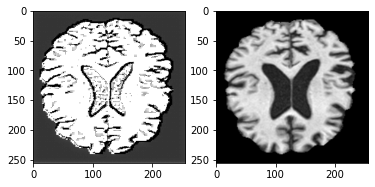

Epoch: 42, G_Loss: 2523052.000000, D_Loss: 0.449611, time: 1.72 min


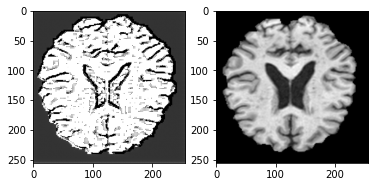

Epoch: 42, G_Loss: 2884112.500000, D_Loss: 0.463735, time: 1.73 min


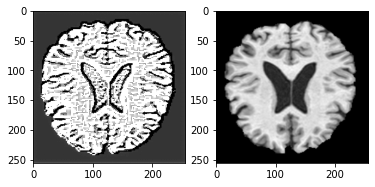

Epoch: 43, G_Loss: 2513428.500000, D_Loss: 0.398902, time: 1.74 min


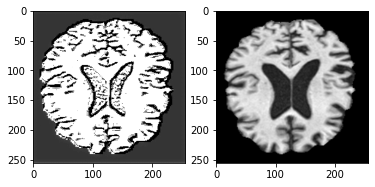

Epoch: 43, G_Loss: 2523043.750000, D_Loss: 0.445835, time: 1.76 min


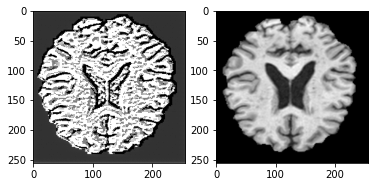

Epoch: 43, G_Loss: 2884107.500000, D_Loss: 0.460222, time: 1.77 min


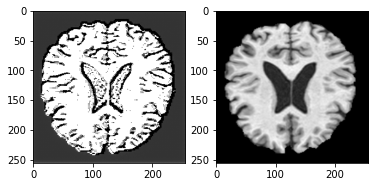

Epoch: 44, G_Loss: 2513425.500000, D_Loss: 0.395475, time: 1.79 min


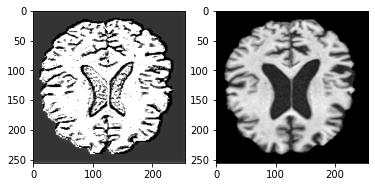

Epoch: 44, G_Loss: 2523043.000000, D_Loss: 0.442103, time: 1.80 min


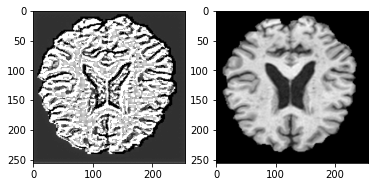

Epoch: 44, G_Loss: 2884110.500000, D_Loss: 0.456743, time: 1.81 min


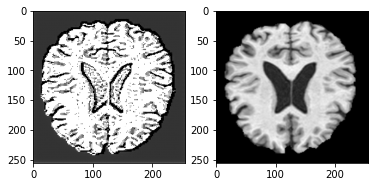

Epoch: 45, G_Loss: 2513428.500000, D_Loss: 0.392070, time: 1.83 min


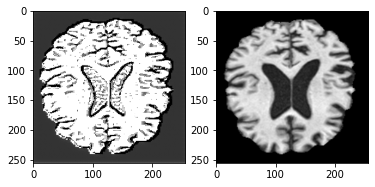

Epoch: 45, G_Loss: 2523048.000000, D_Loss: 0.438408, time: 1.84 min


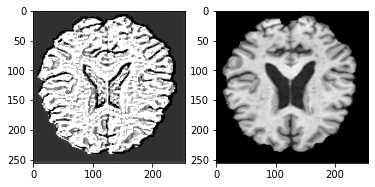

Epoch: 45, G_Loss: 2884111.500000, D_Loss: 0.453295, time: 1.85 min


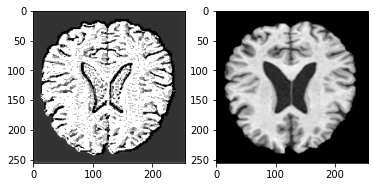

Epoch: 46, G_Loss: 2513429.250000, D_Loss: 0.388697, time: 1.87 min


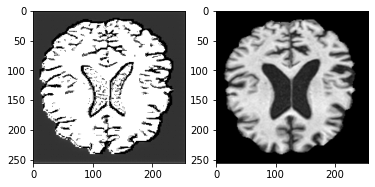

Epoch: 46, G_Loss: 2523048.750000, D_Loss: 0.434748, time: 1.88 min


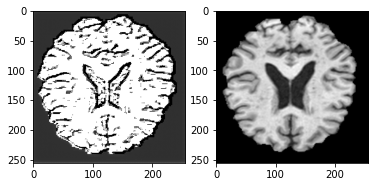

Epoch: 46, G_Loss: 2884108.500000, D_Loss: 0.449878, time: 1.89 min


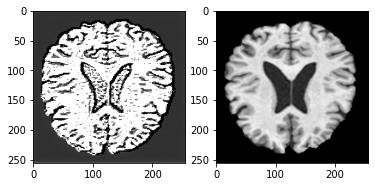

Epoch: 47, G_Loss: 2513424.000000, D_Loss: 0.385369, time: 1.91 min


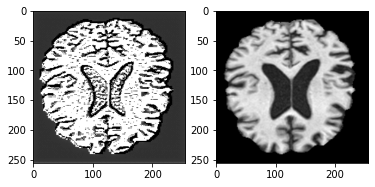

Epoch: 47, G_Loss: 2523037.000000, D_Loss: 0.431122, time: 1.92 min


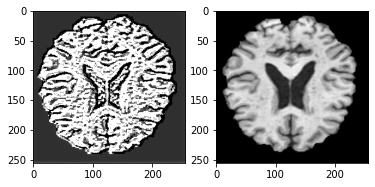

Epoch: 47, G_Loss: 2884102.500000, D_Loss: 0.446493, time: 1.94 min


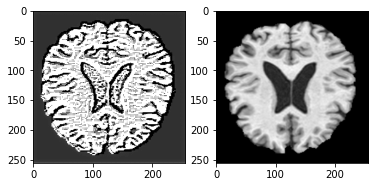

Epoch: 48, G_Loss: 2513424.750000, D_Loss: 0.382084, time: 1.95 min


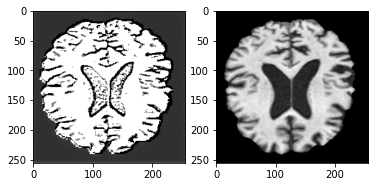

Epoch: 48, G_Loss: 2523043.500000, D_Loss: 0.427547, time: 1.96 min


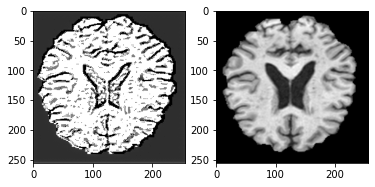

Epoch: 48, G_Loss: 2884105.750000, D_Loss: 0.443138, time: 1.98 min


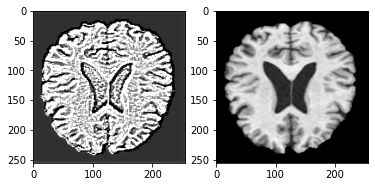

Epoch: 49, G_Loss: 2513428.000000, D_Loss: 0.378820, time: 1.99 min


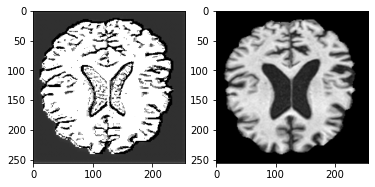

Epoch: 49, G_Loss: 2523044.500000, D_Loss: 0.423995, time: 2.00 min


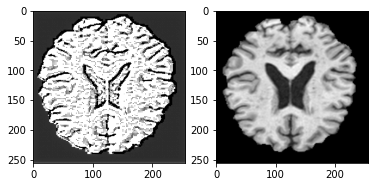

Epoch: 49, G_Loss: 2884108.500000, D_Loss: 0.439813, time: 2.02 min


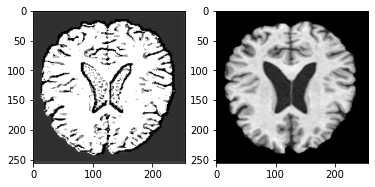

Epoch: 50, G_Loss: 2513425.250000, D_Loss: 0.375588, time: 2.03 min


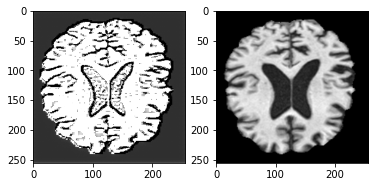

Epoch: 50, G_Loss: 2523043.500000, D_Loss: 0.420485, time: 2.04 min


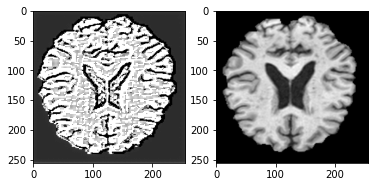

Epoch: 50, G_Loss: 2884106.250000, D_Loss: 0.436518, time: 2.06 min


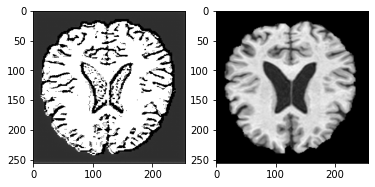

Epoch: 51, G_Loss: 2513420.500000, D_Loss: 0.372395, time: 2.07 min


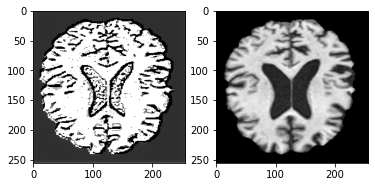

Epoch: 51, G_Loss: 2523036.000000, D_Loss: 0.417012, time: 2.08 min


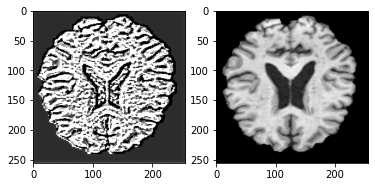

Epoch: 51, G_Loss: 2884101.000000, D_Loss: 0.433258, time: 2.10 min


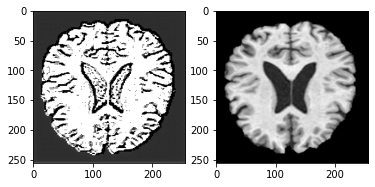

Epoch: 52, G_Loss: 2513420.000000, D_Loss: 0.369240, time: 2.11 min


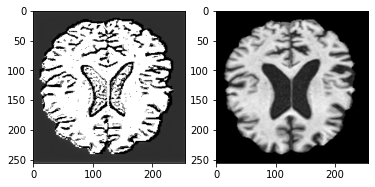

Epoch: 52, G_Loss: 2523038.000000, D_Loss: 0.413573, time: 2.12 min


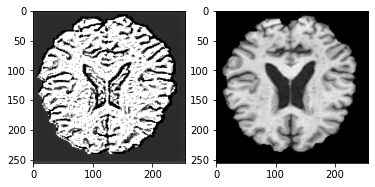

Epoch: 52, G_Loss: 2884100.500000, D_Loss: 0.430023, time: 2.14 min


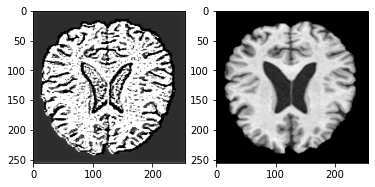

Epoch: 53, G_Loss: 2513419.750000, D_Loss: 0.366117, time: 2.15 min


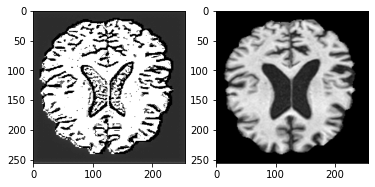

Epoch: 53, G_Loss: 2523033.000000, D_Loss: 0.410163, time: 2.16 min


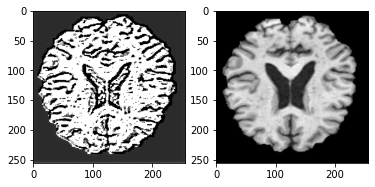

Epoch: 53, G_Loss: 2884095.500000, D_Loss: 0.426819, time: 2.18 min


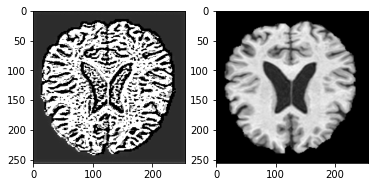

Epoch: 54, G_Loss: 2513419.000000, D_Loss: 0.363029, time: 2.19 min


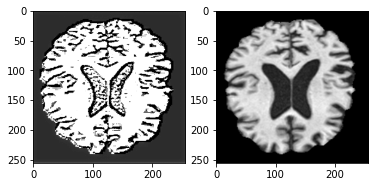

Epoch: 54, G_Loss: 2523032.750000, D_Loss: 0.406801, time: 2.20 min


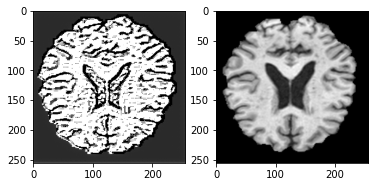

Epoch: 54, G_Loss: 2884097.500000, D_Loss: 0.423645, time: 2.22 min


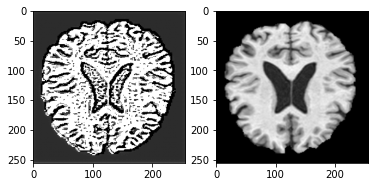

Epoch: 55, G_Loss: 2513417.250000, D_Loss: 0.359971, time: 2.23 min


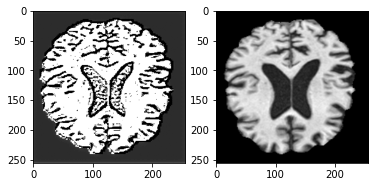

Epoch: 55, G_Loss: 2523030.000000, D_Loss: 0.403458, time: 2.25 min


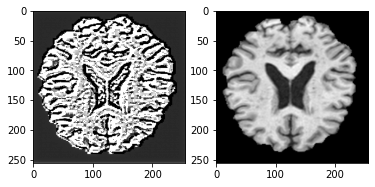

Epoch: 55, G_Loss: 2884098.500000, D_Loss: 0.420498, time: 2.26 min


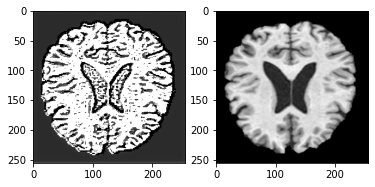

Epoch: 56, G_Loss: 2513418.500000, D_Loss: 0.356944, time: 2.27 min


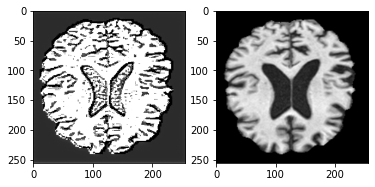

Epoch: 56, G_Loss: 2523035.500000, D_Loss: 0.400161, time: 2.29 min


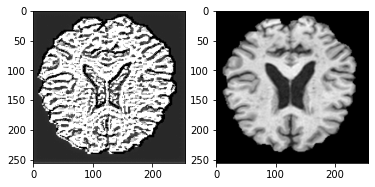

Epoch: 56, G_Loss: 2884101.000000, D_Loss: 0.417381, time: 2.30 min


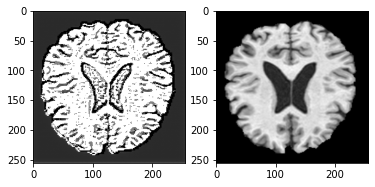

Epoch: 57, G_Loss: 2513421.750000, D_Loss: 0.353945, time: 2.31 min


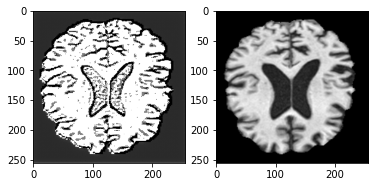

Epoch: 57, G_Loss: 2523039.500000, D_Loss: 0.396895, time: 2.33 min


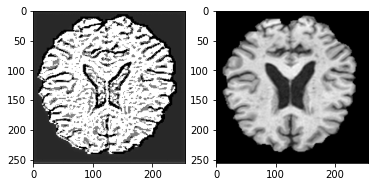

Epoch: 57, G_Loss: 2884101.250000, D_Loss: 0.414292, time: 2.34 min


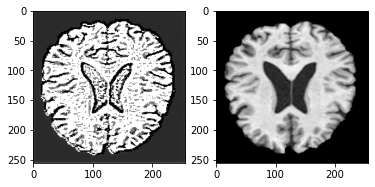

Epoch: 58, G_Loss: 2513420.250000, D_Loss: 0.350979, time: 2.35 min


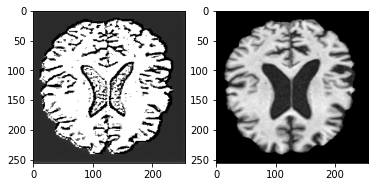

Epoch: 58, G_Loss: 2523034.500000, D_Loss: 0.393661, time: 2.37 min


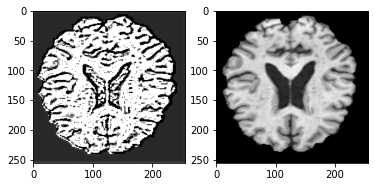

Epoch: 58, G_Loss: 2884094.250000, D_Loss: 0.411233, time: 2.38 min


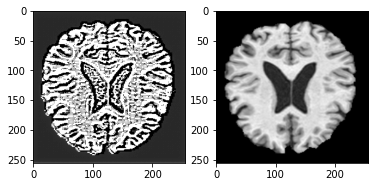

Epoch: 59, G_Loss: 2513420.500000, D_Loss: 0.348050, time: 2.40 min


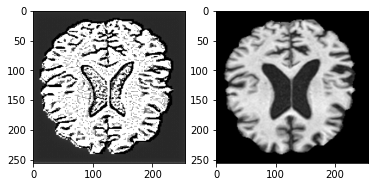

Epoch: 59, G_Loss: 2523034.000000, D_Loss: 0.390458, time: 2.41 min


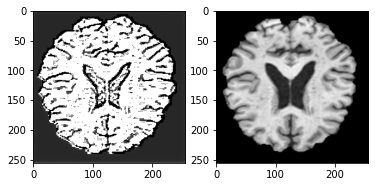

Epoch: 59, G_Loss: 2884100.000000, D_Loss: 0.408200, time: 2.42 min


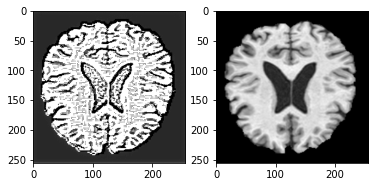

Epoch: 60, G_Loss: 2513421.250000, D_Loss: 0.345145, time: 2.44 min


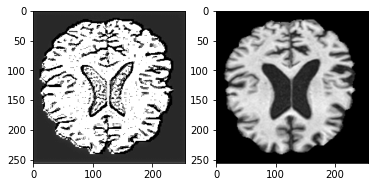

Epoch: 60, G_Loss: 2523035.250000, D_Loss: 0.387290, time: 2.45 min


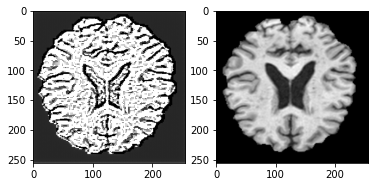

Epoch: 60, G_Loss: 2884098.500000, D_Loss: 0.405198, time: 2.46 min


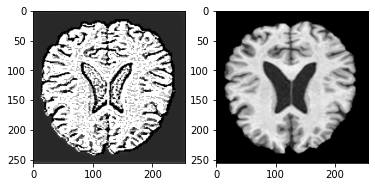

Epoch: 61, G_Loss: 2513419.500000, D_Loss: 0.342274, time: 2.48 min


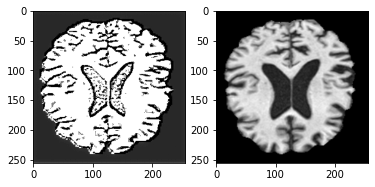

Epoch: 61, G_Loss: 2523035.250000, D_Loss: 0.384152, time: 2.49 min


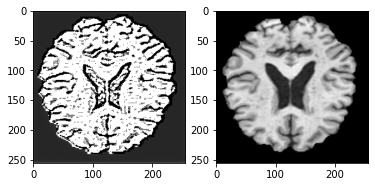

Epoch: 61, G_Loss: 2884095.750000, D_Loss: 0.402222, time: 2.50 min


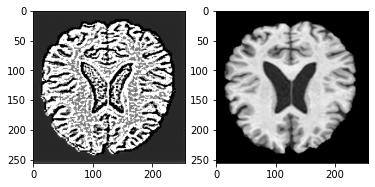

Epoch: 62, G_Loss: 2513419.500000, D_Loss: 0.339434, time: 2.52 min


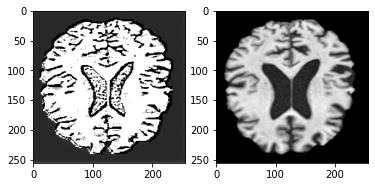

Epoch: 62, G_Loss: 2523032.500000, D_Loss: 0.381047, time: 2.53 min


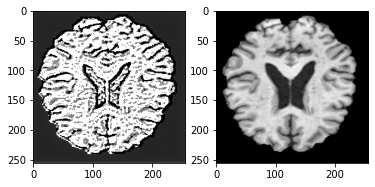

Epoch: 62, G_Loss: 2884096.500000, D_Loss: 0.399272, time: 2.55 min


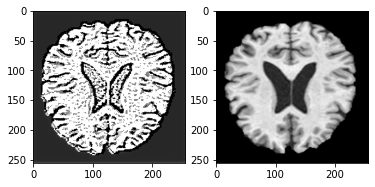

Epoch: 63, G_Loss: 2513417.500000, D_Loss: 0.336624, time: 2.56 min


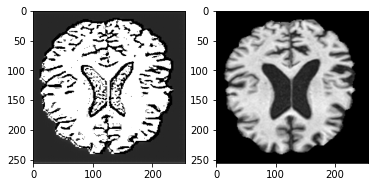

Epoch: 63, G_Loss: 2523032.000000, D_Loss: 0.377972, time: 2.57 min


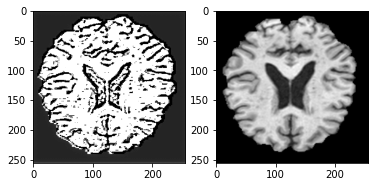

Epoch: 63, G_Loss: 2884093.000000, D_Loss: 0.396351, time: 2.59 min


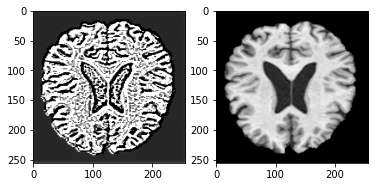

Epoch: 64, G_Loss: 2513417.000000, D_Loss: 0.333842, time: 2.60 min


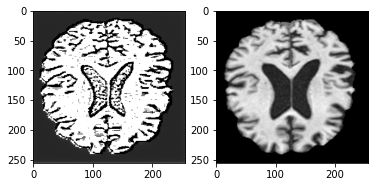

Epoch: 64, G_Loss: 2523029.000000, D_Loss: 0.374931, time: 2.62 min


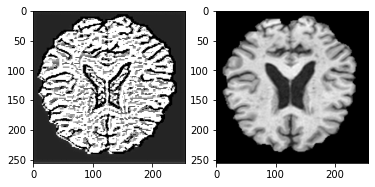

Epoch: 64, G_Loss: 2884096.250000, D_Loss: 0.393450, time: 2.63 min


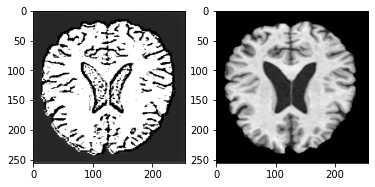

Epoch: 65, G_Loss: 2513415.250000, D_Loss: 0.331084, time: 2.64 min


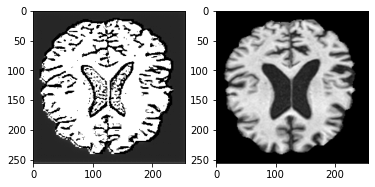

Epoch: 65, G_Loss: 2523030.750000, D_Loss: 0.371923, time: 2.66 min


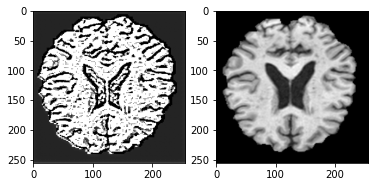

Epoch: 65, G_Loss: 2884091.250000, D_Loss: 0.390584, time: 2.67 min


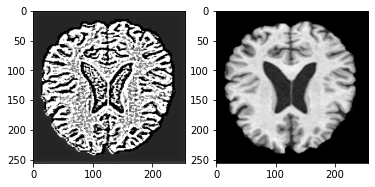

Epoch: 66, G_Loss: 2513417.000000, D_Loss: 0.328362, time: 2.69 min


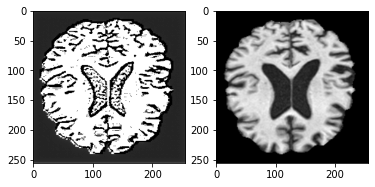

Epoch: 66, G_Loss: 2523027.750000, D_Loss: 0.368938, time: 2.70 min


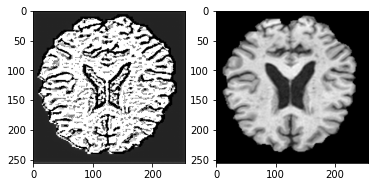

Epoch: 66, G_Loss: 2884092.000000, D_Loss: 0.387744, time: 2.71 min


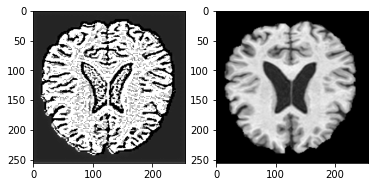

Epoch: 67, G_Loss: 2513415.500000, D_Loss: 0.325668, time: 2.73 min


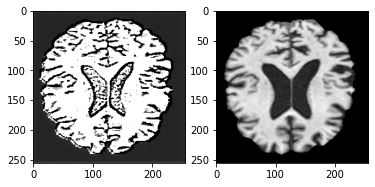

Epoch: 67, G_Loss: 2523029.250000, D_Loss: 0.365991, time: 2.74 min


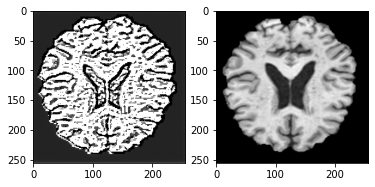

Epoch: 67, G_Loss: 2884092.750000, D_Loss: 0.384925, time: 2.75 min


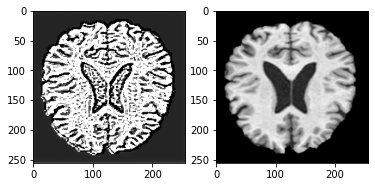

Epoch: 68, G_Loss: 2513414.750000, D_Loss: 0.323005, time: 2.77 min


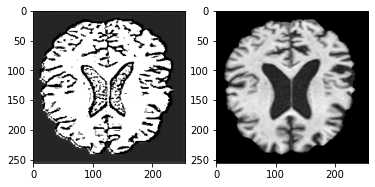

Epoch: 68, G_Loss: 2523029.250000, D_Loss: 0.363069, time: 2.78 min


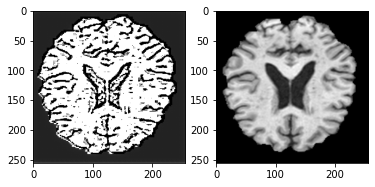

Epoch: 68, G_Loss: 2884091.000000, D_Loss: 0.382136, time: 2.79 min


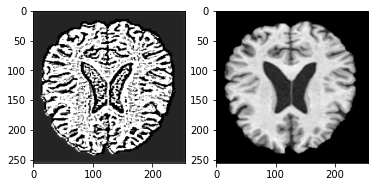

Epoch: 69, G_Loss: 2513413.000000, D_Loss: 0.320359, time: 2.81 min


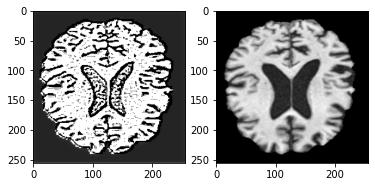

Epoch: 69, G_Loss: 2523022.750000, D_Loss: 0.360176, time: 2.82 min


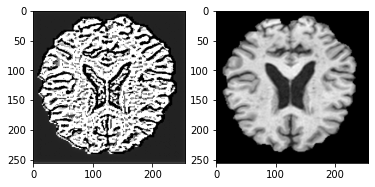

Epoch: 69, G_Loss: 2884089.500000, D_Loss: 0.379369, time: 2.83 min


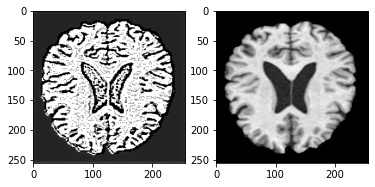

Epoch: 70, G_Loss: 2513413.000000, D_Loss: 0.317750, time: 2.85 min


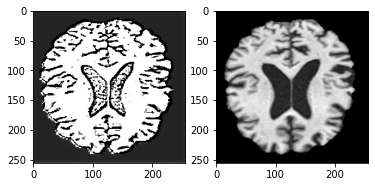

Epoch: 70, G_Loss: 2523028.000000, D_Loss: 0.357320, time: 2.86 min


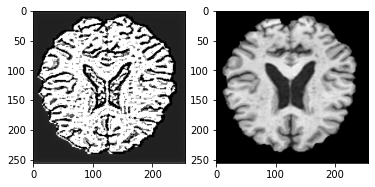

Epoch: 70, G_Loss: 2884090.500000, D_Loss: 0.376632, time: 2.88 min


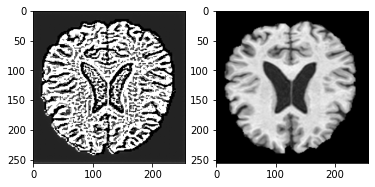

Epoch: 71, G_Loss: 2513416.000000, D_Loss: 0.315171, time: 2.89 min


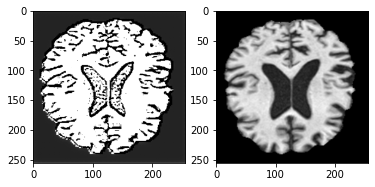

Epoch: 71, G_Loss: 2523029.750000, D_Loss: 0.354484, time: 2.90 min


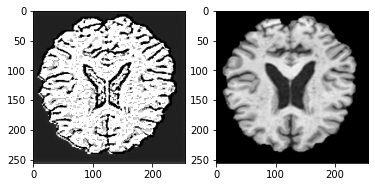

Epoch: 71, G_Loss: 2884093.750000, D_Loss: 0.373915, time: 2.92 min


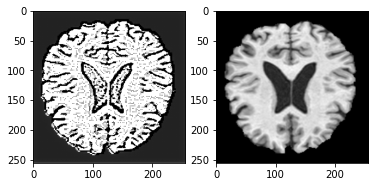

Epoch: 72, G_Loss: 2513413.750000, D_Loss: 0.312606, time: 2.93 min


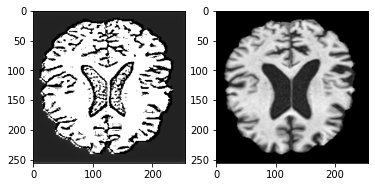

Epoch: 72, G_Loss: 2523026.750000, D_Loss: 0.351683, time: 2.94 min


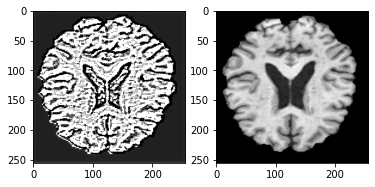

Epoch: 72, G_Loss: 2884091.500000, D_Loss: 0.371224, time: 2.96 min


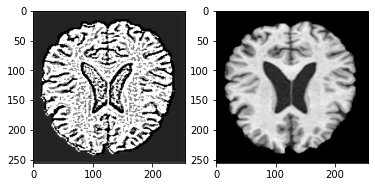

Epoch: 73, G_Loss: 2513414.000000, D_Loss: 0.310074, time: 2.97 min


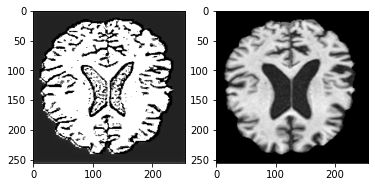

Epoch: 73, G_Loss: 2523028.500000, D_Loss: 0.348910, time: 2.98 min


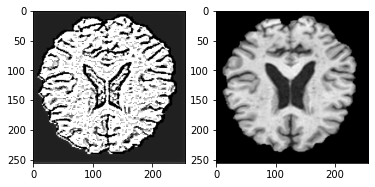

Epoch: 73, G_Loss: 2884092.500000, D_Loss: 0.368560, time: 3.00 min


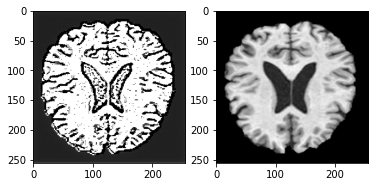

Epoch: 74, G_Loss: 2513411.000000, D_Loss: 0.307574, time: 3.01 min


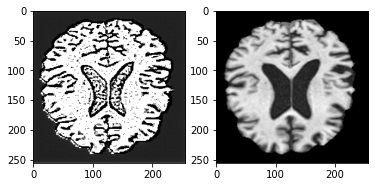

Epoch: 74, G_Loss: 2523022.750000, D_Loss: 0.346156, time: 3.03 min


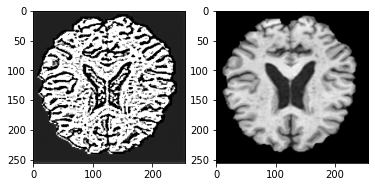

Epoch: 74, G_Loss: 2884086.250000, D_Loss: 0.365919, time: 3.04 min


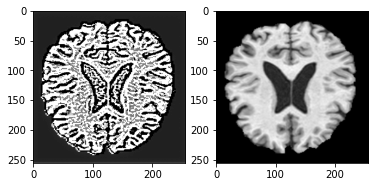

Epoch: 75, G_Loss: 2513415.000000, D_Loss: 0.305105, time: 3.05 min


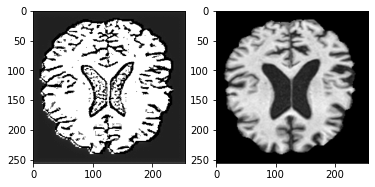

Epoch: 75, G_Loss: 2523027.500000, D_Loss: 0.343441, time: 3.07 min


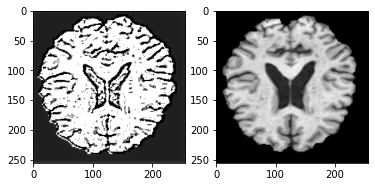

Epoch: 75, G_Loss: 2884092.250000, D_Loss: 0.363302, time: 3.08 min


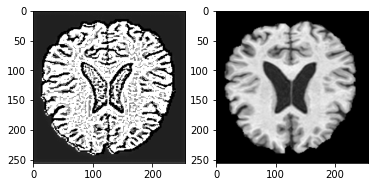

Epoch: 76, G_Loss: 2513413.000000, D_Loss: 0.302644, time: 3.09 min


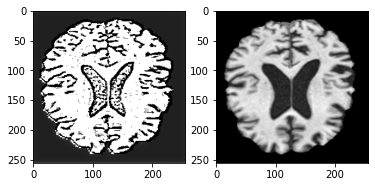

Epoch: 76, G_Loss: 2523024.750000, D_Loss: 0.340743, time: 3.11 min


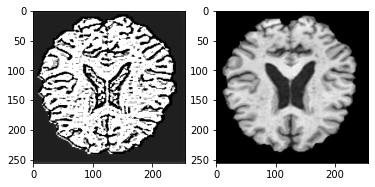

Epoch: 76, G_Loss: 2884087.000000, D_Loss: 0.360710, time: 3.12 min


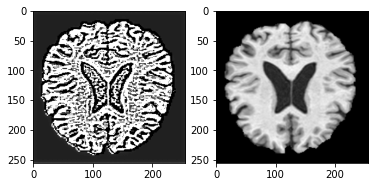

Epoch: 77, G_Loss: 2513413.750000, D_Loss: 0.300220, time: 3.14 min


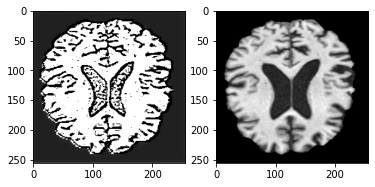

Epoch: 77, G_Loss: 2523022.500000, D_Loss: 0.338080, time: 3.15 min


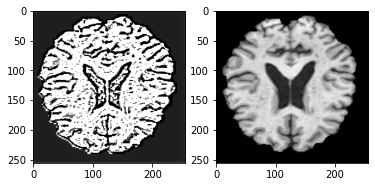

Epoch: 77, G_Loss: 2884087.500000, D_Loss: 0.358142, time: 3.16 min


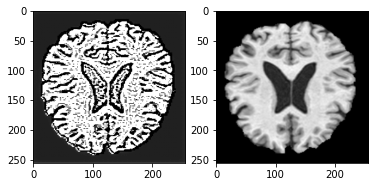

Epoch: 78, G_Loss: 2513410.250000, D_Loss: 0.297817, time: 3.18 min


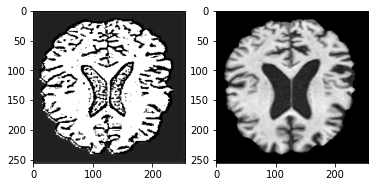

Epoch: 78, G_Loss: 2523022.250000, D_Loss: 0.335443, time: 3.19 min


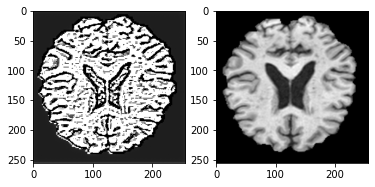

Epoch: 78, G_Loss: 2884086.500000, D_Loss: 0.355594, time: 3.20 min


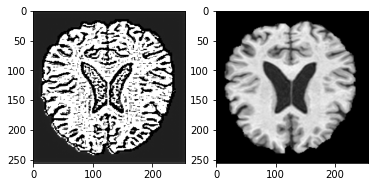

Epoch: 79, G_Loss: 2513408.750000, D_Loss: 0.295440, time: 3.22 min


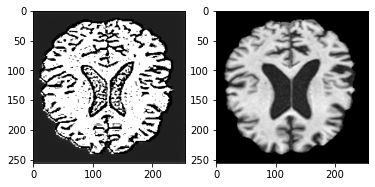

Epoch: 79, G_Loss: 2523019.500000, D_Loss: 0.332830, time: 3.23 min


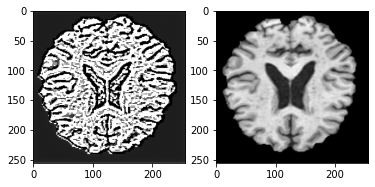

Epoch: 79, G_Loss: 2884087.000000, D_Loss: 0.353071, time: 3.24 min


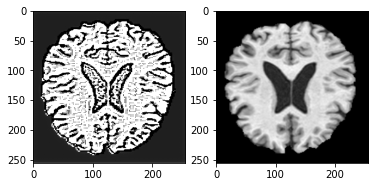

Epoch: 80, G_Loss: 2513410.500000, D_Loss: 0.293090, time: 3.26 min


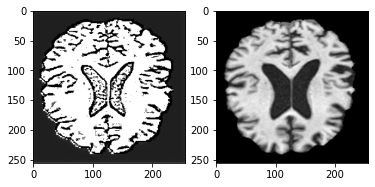

Epoch: 80, G_Loss: 2523025.500000, D_Loss: 0.330245, time: 3.27 min


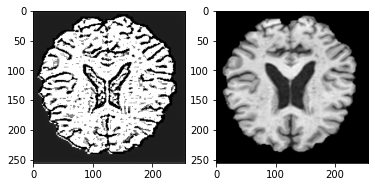

Epoch: 80, G_Loss: 2884088.000000, D_Loss: 0.350572, time: 3.29 min


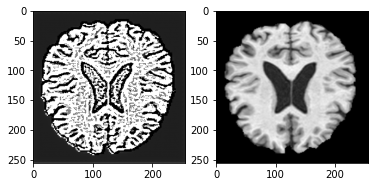

Epoch: 81, G_Loss: 2513410.500000, D_Loss: 0.290755, time: 3.30 min


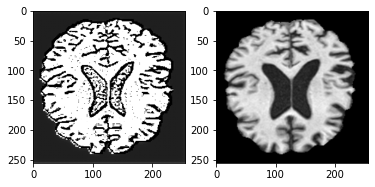

Epoch: 81, G_Loss: 2523021.250000, D_Loss: 0.327681, time: 3.31 min


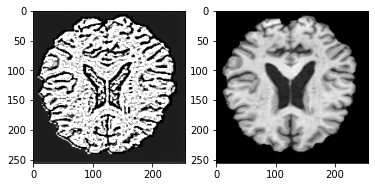

Epoch: 81, G_Loss: 2884086.000000, D_Loss: 0.348096, time: 3.33 min


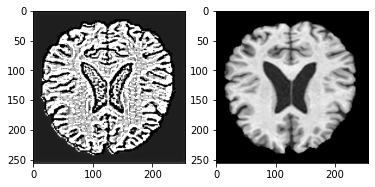

Epoch: 82, G_Loss: 2513413.500000, D_Loss: 0.288457, time: 3.34 min


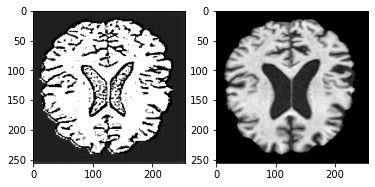

Epoch: 82, G_Loss: 2523024.500000, D_Loss: 0.325151, time: 3.35 min


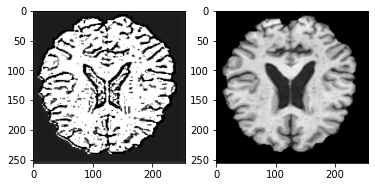

Epoch: 82, G_Loss: 2884088.000000, D_Loss: 0.345636, time: 3.37 min


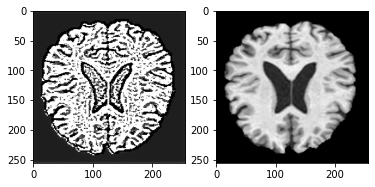

Epoch: 83, G_Loss: 2513411.000000, D_Loss: 0.286170, time: 3.38 min


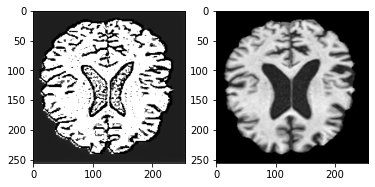

Epoch: 83, G_Loss: 2523023.000000, D_Loss: 0.322641, time: 3.39 min


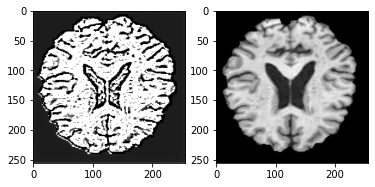

Epoch: 83, G_Loss: 2884086.500000, D_Loss: 0.343209, time: 3.41 min


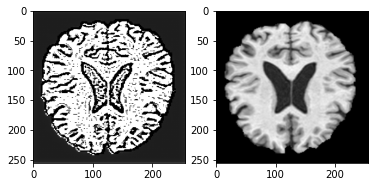

Epoch: 84, G_Loss: 2513407.500000, D_Loss: 0.283918, time: 3.42 min


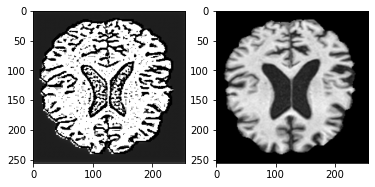

Epoch: 84, G_Loss: 2523016.250000, D_Loss: 0.320151, time: 3.44 min


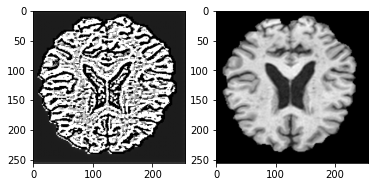

Epoch: 84, G_Loss: 2884086.000000, D_Loss: 0.340793, time: 3.45 min


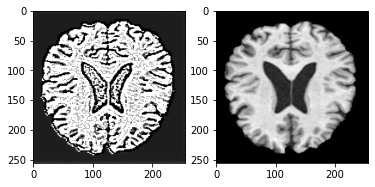

Epoch: 85, G_Loss: 2513410.250000, D_Loss: 0.281685, time: 3.46 min


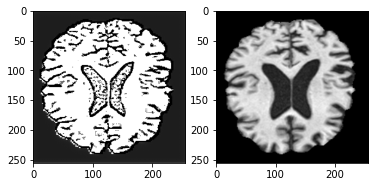

Epoch: 85, G_Loss: 2523026.000000, D_Loss: 0.317701, time: 3.48 min


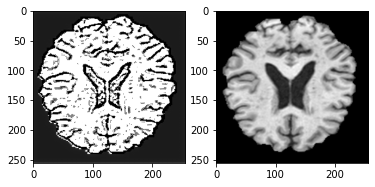

Epoch: 85, G_Loss: 2884089.000000, D_Loss: 0.338407, time: 3.49 min


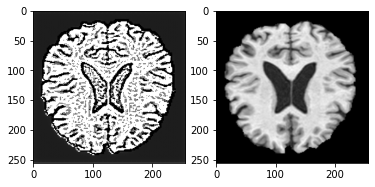

Epoch: 86, G_Loss: 2513410.500000, D_Loss: 0.279471, time: 3.50 min


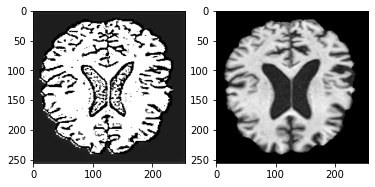

Epoch: 86, G_Loss: 2523021.000000, D_Loss: 0.315264, time: 3.52 min


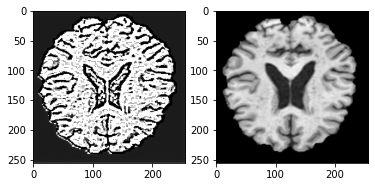

Epoch: 86, G_Loss: 2884085.000000, D_Loss: 0.336042, time: 3.53 min


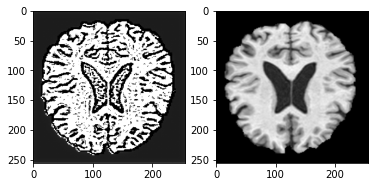

Epoch: 87, G_Loss: 2513406.000000, D_Loss: 0.277288, time: 3.55 min


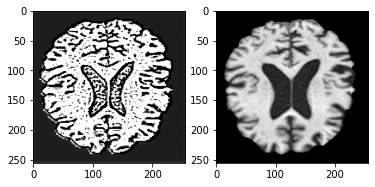

Epoch: 87, G_Loss: 2523014.750000, D_Loss: 0.312849, time: 3.56 min


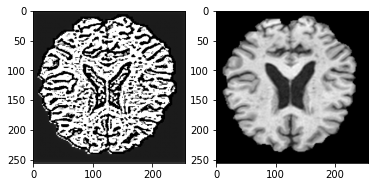

Epoch: 87, G_Loss: 2884081.500000, D_Loss: 0.333696, time: 3.57 min


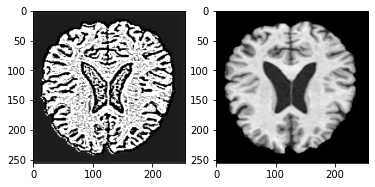

Epoch: 88, G_Loss: 2513408.250000, D_Loss: 0.275122, time: 3.59 min


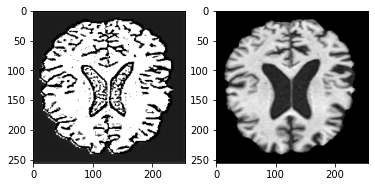

Epoch: 88, G_Loss: 2523021.000000, D_Loss: 0.310465, time: 3.60 min


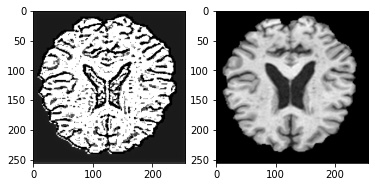

Epoch: 88, G_Loss: 2884085.500000, D_Loss: 0.331374, time: 3.61 min


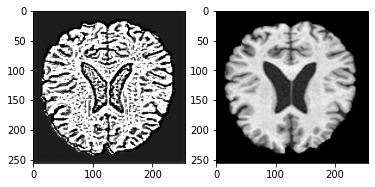

Epoch: 89, G_Loss: 2513409.000000, D_Loss: 0.272978, time: 3.63 min


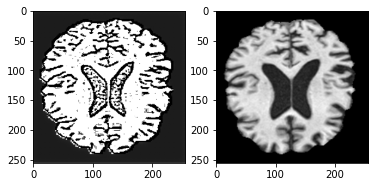

Epoch: 89, G_Loss: 2523019.000000, D_Loss: 0.308102, time: 3.64 min


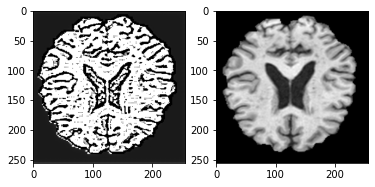

Epoch: 89, G_Loss: 2884082.500000, D_Loss: 0.329070, time: 3.66 min


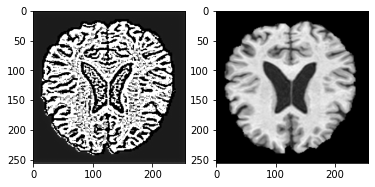

Epoch: 90, G_Loss: 2513409.000000, D_Loss: 0.270854, time: 3.67 min


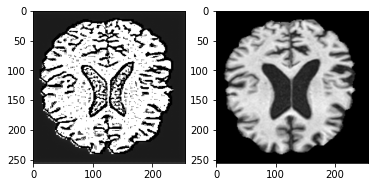

Epoch: 90, G_Loss: 2523017.500000, D_Loss: 0.305761, time: 3.68 min


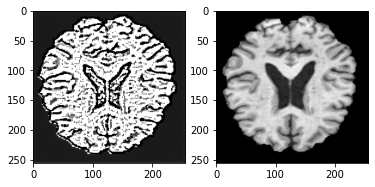

Epoch: 90, G_Loss: 2884085.000000, D_Loss: 0.326788, time: 3.70 min


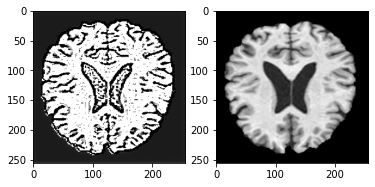

Epoch: 91, G_Loss: 2513406.000000, D_Loss: 0.268755, time: 3.71 min


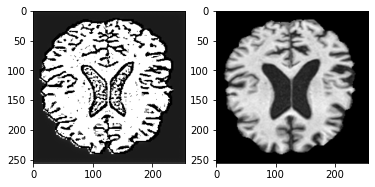

Epoch: 91, G_Loss: 2523017.750000, D_Loss: 0.303442, time: 3.72 min


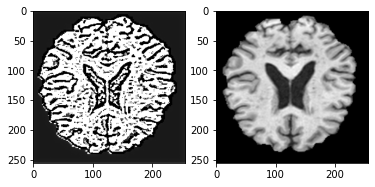

Epoch: 91, G_Loss: 2884081.000000, D_Loss: 0.324526, time: 3.74 min


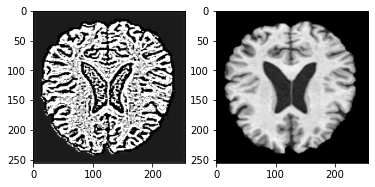

Epoch: 92, G_Loss: 2513409.000000, D_Loss: 0.266678, time: 3.75 min


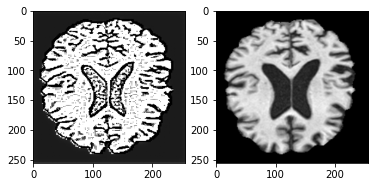

Epoch: 92, G_Loss: 2523018.000000, D_Loss: 0.301153, time: 3.77 min


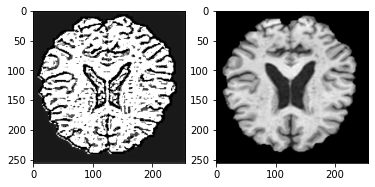

Epoch: 92, G_Loss: 2884084.750000, D_Loss: 0.322285, time: 3.78 min


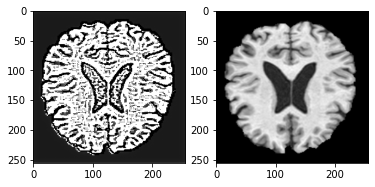

Epoch: 93, G_Loss: 2513409.000000, D_Loss: 0.264620, time: 3.79 min


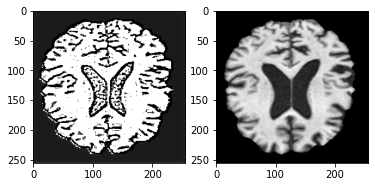

Epoch: 93, G_Loss: 2523019.000000, D_Loss: 0.298883, time: 3.81 min


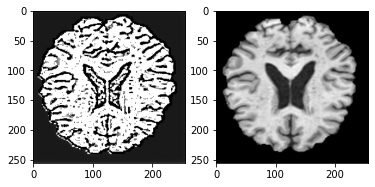

Epoch: 93, G_Loss: 2884082.500000, D_Loss: 0.320064, time: 3.82 min


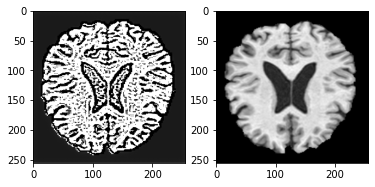

Epoch: 94, G_Loss: 2513406.250000, D_Loss: 0.262584, time: 3.83 min


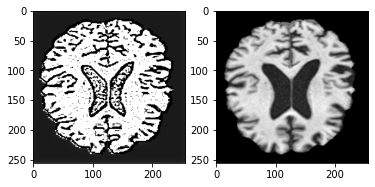

Epoch: 94, G_Loss: 2523016.000000, D_Loss: 0.296634, time: 3.85 min


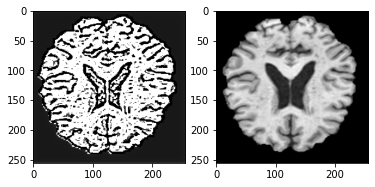

Epoch: 94, G_Loss: 2884080.500000, D_Loss: 0.317862, time: 3.86 min


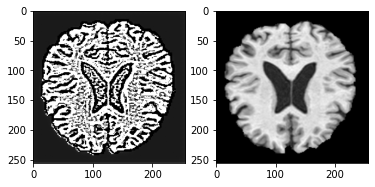

Epoch: 95, G_Loss: 2513408.750000, D_Loss: 0.260570, time: 3.87 min


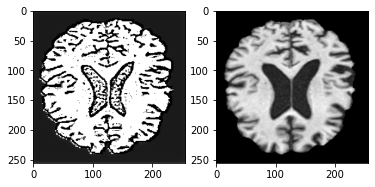

Epoch: 95, G_Loss: 2523016.750000, D_Loss: 0.294407, time: 3.89 min


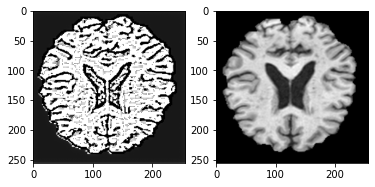

Epoch: 95, G_Loss: 2884083.000000, D_Loss: 0.315683, time: 3.90 min


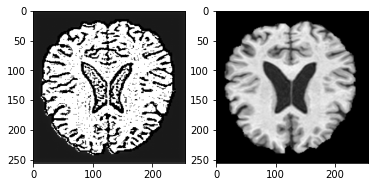

Epoch: 96, G_Loss: 2513404.000000, D_Loss: 0.258570, time: 3.92 min


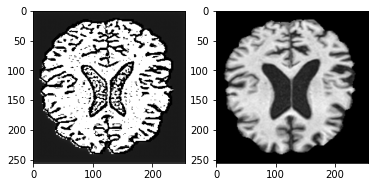

Epoch: 96, G_Loss: 2523013.500000, D_Loss: 0.292204, time: 3.93 min


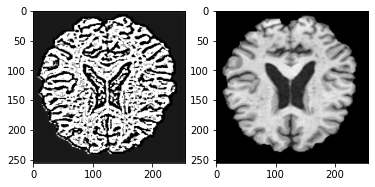

Epoch: 96, G_Loss: 2884080.000000, D_Loss: 0.313519, time: 3.94 min


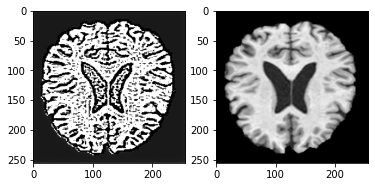

Epoch: 97, G_Loss: 2513405.500000, D_Loss: 0.256596, time: 3.96 min


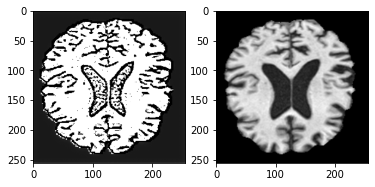

Epoch: 97, G_Loss: 2523017.250000, D_Loss: 0.290021, time: 3.97 min


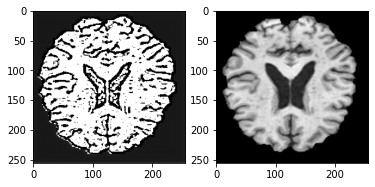

Epoch: 97, G_Loss: 2884082.000000, D_Loss: 0.311380, time: 3.98 min


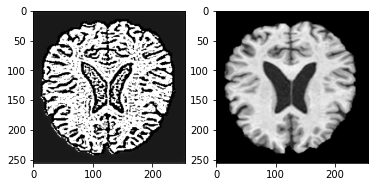

Epoch: 98, G_Loss: 2513404.250000, D_Loss: 0.254642, time: 4.00 min


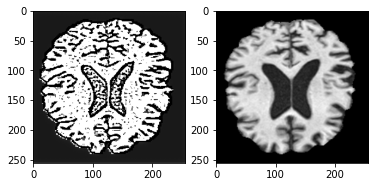

Epoch: 98, G_Loss: 2523012.500000, D_Loss: 0.287862, time: 4.01 min


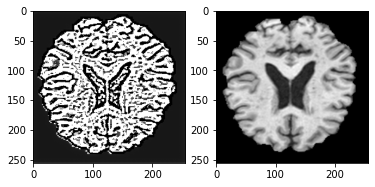

Epoch: 98, G_Loss: 2884080.500000, D_Loss: 0.309254, time: 4.02 min


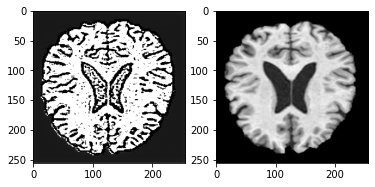

Epoch: 99, G_Loss: 2513402.750000, D_Loss: 0.252707, time: 4.04 min


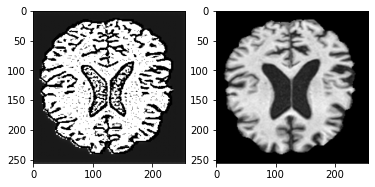

Epoch: 99, G_Loss: 2523013.000000, D_Loss: 0.285721, time: 4.05 min


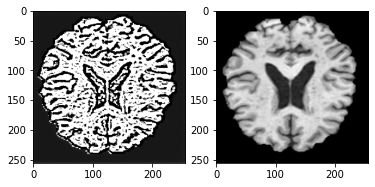

Epoch: 99, G_Loss: 2884078.250000, D_Loss: 0.307151, time: 4.07 min


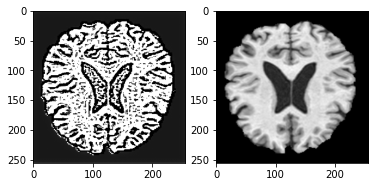

In [14]:
# 학습
model_gen.train()
model_dis.train()

batch_count = 0
num_epochs = 100
start_time = time.time()

loss_hist = {'gen':[],
             'dis':[]}

for epoch in range(num_epochs):
    for i, z in enumerate(zip(orig, target)):
        a, b = z
        # GPU memory 때문에 MRI 영상 중간에 있는 80개의 dicom 파일을 사용하였습니다.
        a = a[40:120, :, :, :]
        b = b[40:120, :, :, :]
        ba_si = a.size(0)
        
        # real image
        real_a = a.to(device)
        real_b = b.to(device)
        
        real_label = torch.ones(2)
        fake_label = torch.zeros(2)
        real_label[1] = 0
        fake_label[1] = 1
        
        real_label, fake_label = real_label.to(device), fake_label.to(device)

        # generator
        model_gen.train()
        model_dis.eval()
        model_gen.zero_grad()

        fake_b = model_gen(real_a) # 가짜 이미지 생성
        out_dis = model_dis(fake_b, real_b) # 가짜 이미지 

        grad_loss = gradient_loss(fake_b, real_b)
        gen_loss = loss_func_gan(out_dis, real_label)
        pixel_loss = loss_func_pix(fake_b, real_b)

        g_loss = (lambda_gen * gen_loss) + (lambda_pixel * pixel_loss) + (lambda_gradient * grad_loss)
        g_loss.backward()
        opt_gen.step()

        # discriminator
        model_dis.train()
        model_dis.zero_grad()

        out_dis = model_dis(real_b, real_a) # 진짜 이미지 식별
        real_loss = loss_func_gan(out_dis,real_label)

        out_dis = model_dis(fake_b.detach(), real_a) # 가짜 이미지 식별
        fake_loss = loss_func_gan(out_dis,fake_label)

        d_loss = (real_loss + fake_loss) / 2.
        d_loss.backward()
        opt_dis.step()

        loss_hist['gen'].append(g_loss.item())
        loss_hist['dis'].append(d_loss.item())
        
        batch_count += 1
        if batch_count % 1 == 0:
            print('Epoch: %.0f, G_Loss: %.6f, D_Loss: %.6f, time: %.2f min' %(epoch, g_loss.item(), d_loss.item(), (time.time()-start_time)/60))

            fake_imgs = model_gen(a.to(device)).detach().cpu()
            real_imgs = (b.to(device)).detach().cpu()
            
            real_imgs = np.squeeze(real_imgs[50])
            fake_imgs = np.squeeze(fake_imgs[50])
            
            fig = plt.figure()
            ax1 = fig.add_subplot(1,2,1)
            ax2 = fig.add_subplot(1,2,2)
            ax1.imshow(fake_imgs, cmap='gray')
            ax2.imshow(real_imgs, cmap='gray')
            plt.show()
    
        
        del a
        del b
        del real_label
        del fake_label 

### Test Results

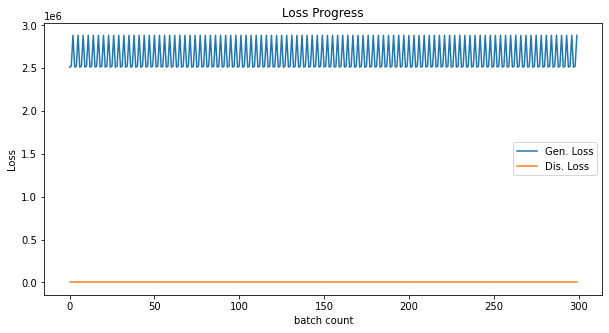

In [15]:
# loss history
plt.figure(figsize=(10,5))
plt.title('Loss Progress')
plt.plot(loss_hist['gen'], label='Gen. Loss')
plt.plot(loss_hist['dis'], label='Dis. Loss')
plt.xlabel('batch count')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [16]:
# 가중치 저장
path2models = '/home/mri-any/GAN_weight/'
os.makedirs(path2models, exist_ok=True)
path2weights_gen = os.path.join(path2models, 'weights_gen.pt')
path2weights_dis = os.path.join(path2models, 'weights_dis.pt')

torch.save(model_gen.state_dict(), path2weights_gen)
torch.save(model_dis.state_dict(), path2weights_dis)

In [17]:
# 가중치 불러오기
weights = torch.load(path2weights_gen)
model_gen.load_state_dict(weights)

<All keys matched successfully>

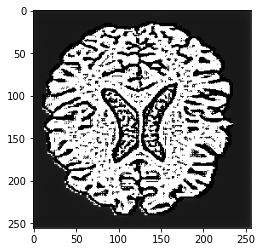

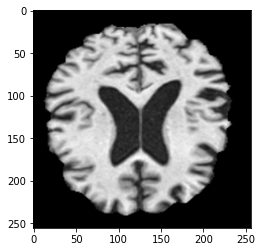

In [18]:
# evaluation model
model_gen.eval()

# 가짜 이미지 생성
with torch.no_grad():
    for a,b in zip(orig, target):
        fake_imgs = model_gen(a.to(device)).detach().cpu()
        fake_imgs = np.squeeze(fake_imgs[90])
        plt.imshow(fake_imgs, cmap='gray')
        plt.figure()
        real_imgs = b
        real_imgs = np.squeeze(real_imgs[90])
        plt.imshow(real_imgs, cmap='gray')
        break

In [19]:
from skimage.metrics import structural_similarity as ssim

fake_np = fake_imgs.numpy()
real_np = real_imgs.numpy()

s = ssim(fake_np, real_np)

print(s)

0.2900011513410739
